# Разведочный анализ

Загрузка необходимых на данном этапе библиотек. Остальные будут подгружаться по мере необходимости. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

warnings.filterwarnings('ignore')
np.set_printoptions(precision=3, suppress=True)
sns.set() # устанавливает вид графиков seaborn, отличный от графиков с настройками matplotlib по умолчанию

Данные состоят из двух файлов, смотрю на каждый из них в отдельности.

In [2]:
X_bp = pd.read_excel('X_bp.xlsx')
X_bp.head()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0
1,1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0
2,2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0
3,3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0
4,4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0


In [3]:
X_nup = pd.read_excel('X_nup.xlsx')
X_nup.head()

,Unnamed: 0,"Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,0,0,4.0,57.0
1,1,0,4.0,60.0
2,2,0,4.0,70.0
3,3,0,5.0,47.0
4,4,0,5.0,57.0


In [4]:
X_bp.shape, X_nup.shape

((1023, 11), (1040, 4))

Размерность у таблиц разная, часть строк из второй таблицы будет откинута.

Для красоты можно поменять название столбцов. Для id это совсем необязательно, т.к. далее этот столбец будет удален. 

In [5]:
X_bp.rename(columns = {'Unnamed: 0' : 'id', 'модуль упругости, ГПа' : 'Модуль упругости, ГПа'}, inplace=True)
X_nup.rename(columns = {'Unnamed: 0' : 'id'}, inplace=True)

In [6]:
# Соединяю по id.
df = X_bp.merge(X_nup, on='id')

In [7]:
df.head(10)

,id,Соотношение матрица-наполнитель,"Плотность, кг/м3","Модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0,0,4.0,57.0
1,1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
2,2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,70.0
3,3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
4,4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0
5,5,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,60.0
6,6,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,70.0
7,7,2.561475,1900.0,535.000000,111.86,22.267857,284.615385,380.0,75.0,1800.0,120.0,0,7.0,47.0
8,8,3.557018,1930.0,889.000000,129.00,21.250000,300.000000,380.0,75.0,1800.0,120.0,0,7.0,57.0
9,9,3.532338,2100.0,1421.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,7.0,60.0


Смотрю на данные в таблице: их тип, количество пропусков. 

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1023 entries, 0 to 1022
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   id                                    1023 non-null   int64  
 1   Соотношение матрица-наполнитель       1023 non-null   float64
 2   Плотность, кг/м3                      1023 non-null   float64
 3   Модуль упругости, ГПа                 1023 non-null   float64
 4   Количество отвердителя, м.%           1023 non-null   float64
 5   Содержание эпоксидных групп,%_2       1023 non-null   float64
 6   Температура вспышки, С_2              1023 non-null   float64
 7   Поверхностная плотность, г/м2         1023 non-null   float64
 8   Модуль упругости при растяжении, ГПа  1023 non-null   float64
 9   Прочность при растяжении, МПа         1023 non-null   float64
 10  Потребление смолы, г/м2               1023 non-null   float64
 11  Угол нашивки, гра

In [9]:
# статистики
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,1023.0,511.000000,295.458965,0.000000,255.500000,511.000000,766.500000,1022.000000
Соотношение матрица-наполнитель,1023.0,2.930366,0.913222,0.389403,2.317887,2.906878,3.552660,5.591742
"Плотность, кг/м3",1023.0,1975.734888,73.729231,1731.764635,1924.155467,1977.621657,2021.374375,2207.773481
"Модуль упругости, ГПа",1023.0,739.923233,330.231581,2.436909,500.047452,739.664328,961.812526,1911.536477
"Количество отвердителя, м.%",1023.0,110.570769,28.295911,17.740275,92.443497,110.564840,129.730366,198.953207
"Содержание эпоксидных групп,%_2",1023.0,22.244390,2.406301,14.254985,20.608034,22.230744,23.961934,33.000000
"Температура вспышки, С_2",1023.0,285.882151,40.943260,100.000000,259.066528,285.896812,313.002106,413.273418
"Поверхностная плотность, г/м2",1023.0,482.731833,281.314690,0.603740,266.816645,451.864365,693.225017,1399.542362
"Модуль упругости при растяжении, ГПа",1023.0,73.328571,3.118983,64.054061,71.245018,73.268805,75.356612,82.682051
"Прочность при растяжении, МПа",1023.0,2466.922843,485.628006,1036.856605,2135.850448,2459.524526,2767.193119,3848.436732


In [10]:
# количество уникальных значений
df.nunique()

id                                      1023
Соотношение матрица-наполнитель         1014
Плотность, кг/м3                        1013
Модуль упругости, ГПа                   1020
Количество отвердителя, м.%             1005
Содержание эпоксидных групп,%_2         1004
Температура вспышки, С_2                1003
Поверхностная плотность, г/м2           1004
Модуль упругости при растяжении, ГПа    1004
Прочность при растяжении, МПа           1004
Потребление смолы, г/м2                 1003
Угол нашивки, град                         2
Шаг нашивки                              989
Плотность нашивки                        988
dtype: int64

In [11]:
# количество дубликатов
df.duplicated().sum()

0

Избавимся от id в данных для визуализации. Да и в целом этот столбец неинформативен. 

In [12]:
df_no_id = df.copy()

In [13]:
df_no_id.drop(columns=['id'], axis=1, inplace=True)


Строю матрицу корреляции. По ней не видны линейные зависимости между признаками, т.е. нельзя сократить количество признаков. Также не прослеживается зависимость между признаками и целевыми переменными. 

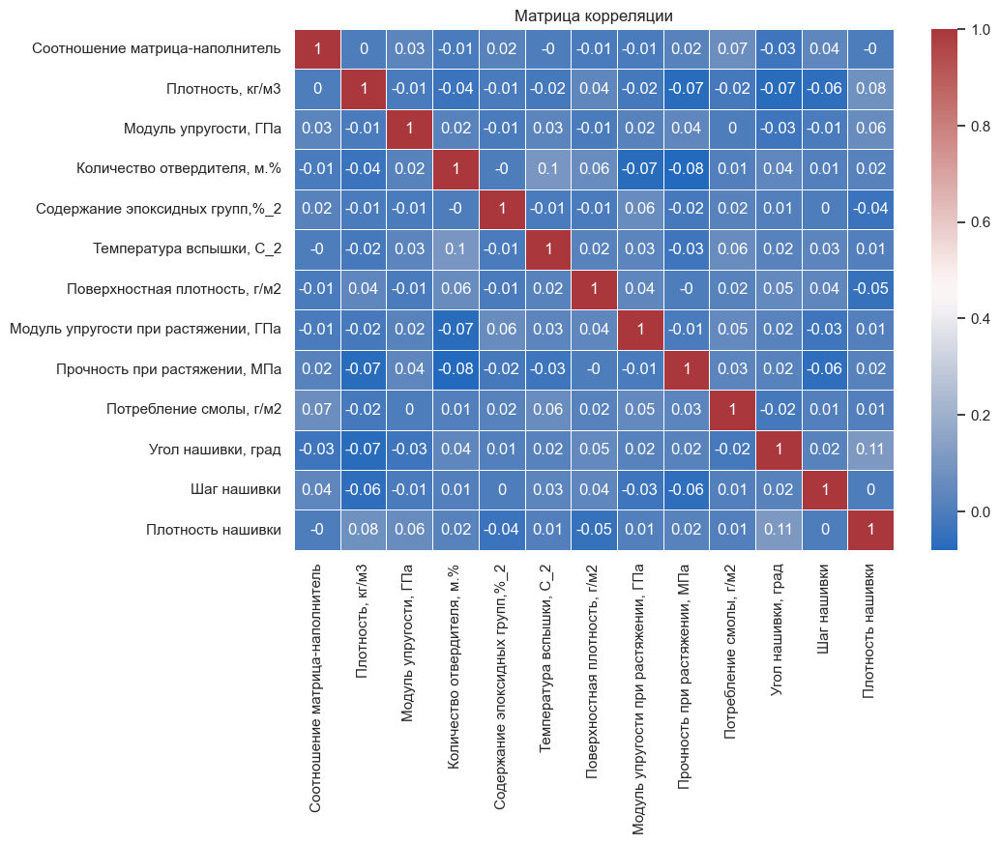

In [14]:
plt.figure(figsize=(10, 7))

corr_matrix = df_no_id.corr()
corr_matrix = np.round(corr_matrix, 2)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='vlag')

plt.title('Матрица корреляции')
plt.show()

Отдельно более детально посмотрю на распределение целевых переменных. Их две: **Модуль упругости при растяжении, ГПа** и **Прочность при растяжении, МПа**. Также посчитаю среднюю и медиану и размещу их на графике распределения. 

In [15]:
target1_mean = round(df['Модуль упругости при растяжении, ГПа'].mean(), 2)
target1_median = df['Модуль упругости при растяжении, ГПа'].median()

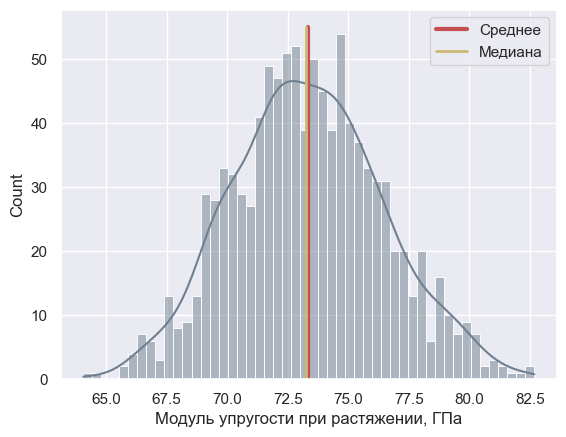

In [16]:
sns.histplot(df['Модуль упругости при растяжении, ГПа'], kde=True, color='slategray', bins=50)
plt.plot([target1_mean] * 2, (0, 55), linewidth=3, color='r', label='Среднее')
plt.plot([target1_median] * 2, (0, 55), linewidth=2, color='y', label='Медиана')
plt.legend()
plt.show()

Посмотрю на выбросы по "ящику с усами".

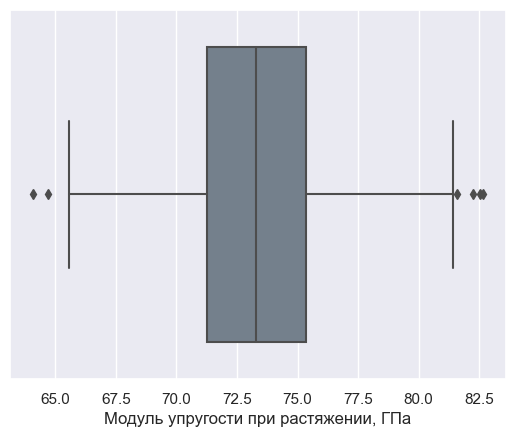

In [17]:
sns.boxplot(df['Модуль упругости при растяжении, ГПа'], color='slategray');

In [18]:
target2_mean = round(df['Прочность при растяжении, МПа'].mean(), 2)
target2_median = df['Прочность при растяжении, МПа'].median()

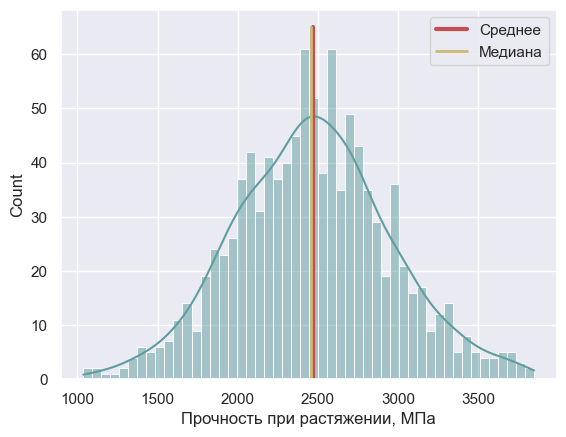

In [19]:
sns.histplot(df['Прочность при растяжении, МПа'], kde=True, color='cadetblue', bins=50)
plt.plot([target2_mean] * 2, (0, 65), linewidth=3, color='r', label='Среднее')
plt.plot([target2_median] * 2, (0, 65), linewidth=2, color='y', label='Медиана')
plt.legend()
plt.show()

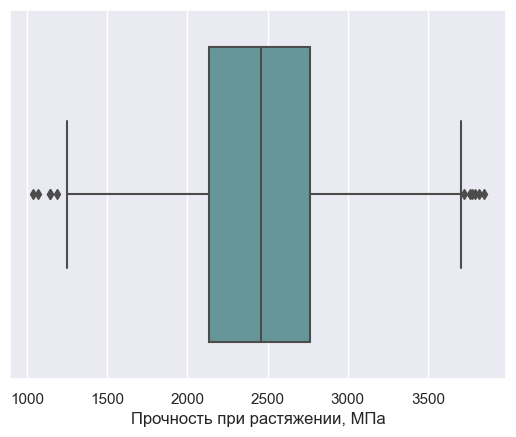

In [20]:
sns.boxplot(df['Прочность при растяжении, МПа'], color='cadetblue');

Можно сразу посмотреть также и на третью целевую переменную. 

In [21]:
target3_mean = round(df['Соотношение матрица-наполнитель'].mean(), 2)
target3_median = df['Соотношение матрица-наполнитель'].median()

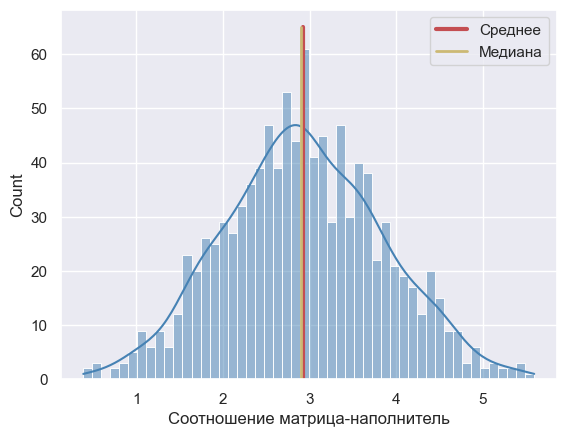

In [22]:
sns.histplot(df['Соотношение матрица-наполнитель'], kde=True, color='steelblue', bins=50)
plt.plot([target3_mean] * 2, (0, 65), linewidth=3, color='r', label='Среднее')
plt.plot([target3_median] * 2, (0, 65), linewidth=2, color='y', label='Медиана')
plt.legend()
plt.show()

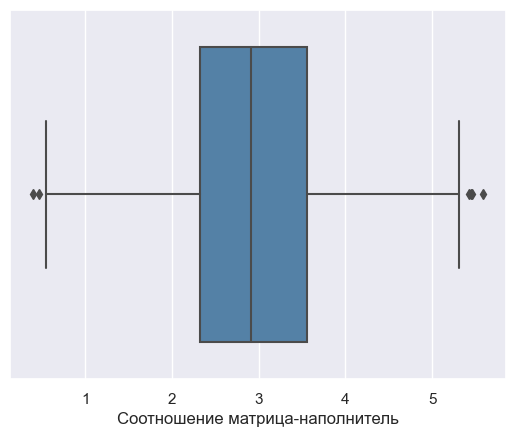

In [23]:
sns.boxplot(df['Соотношение матрица-наполнитель'], color='steelblue');

Можно визуализировать распределение всех признаков, кроме, пожалуй, угла нашивки, т.к. он принимает только 2 значения и ведет себя скорее как категориальная переменная.

Тем не менее, кодировать угол нашивки как категориальную переменную не буду, т.к. вообще могут встречаться и другие значения угла нашивки. 

Шкалу с количеством масштабирую одинаково для всех графиков. 

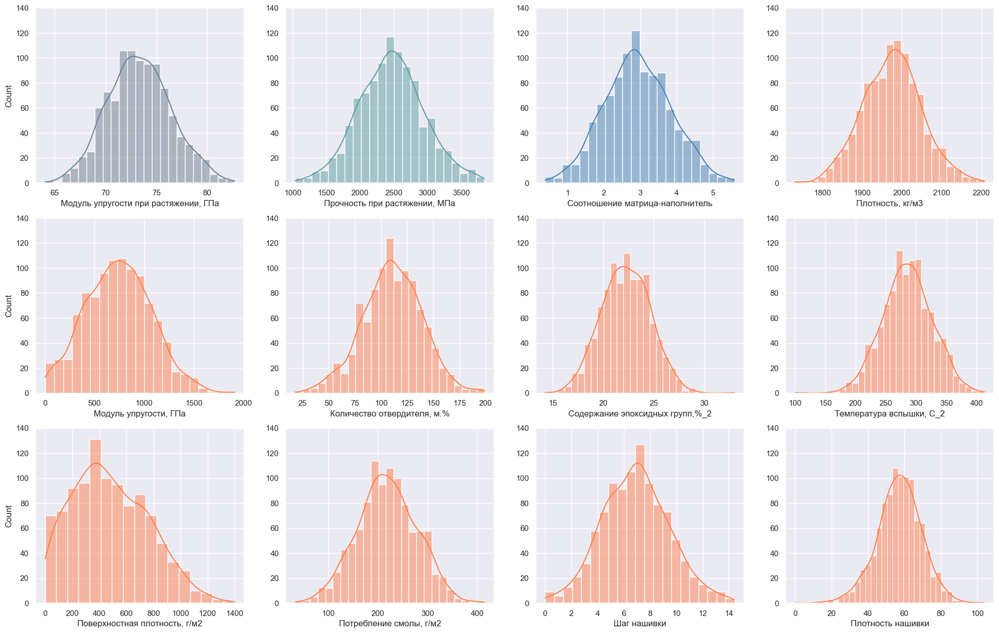

In [24]:
fig, axes = plt.subplots(3, 4, figsize=(24, 15))

hist = sns.histplot(df['Модуль упругости при растяжении, ГПа'], kde=True, color='slategray', ax=axes[0, 0])
hist.set_ylim(0, 140)


hist = sns.histplot(df['Прочность при растяжении, МПа'], kde=True, ax=axes[0, 1], color='cadetblue')
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Соотношение матрица-наполнитель'], kde=True, color='steelblue', ax=axes[0, 2])
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Плотность, кг/м3'], kde=True, color='coral', ax=axes[0, 3])
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Модуль упругости, ГПа'], kde=True, color='coral', ax=axes[1, 0])
hist.set_ylim(0, 140)

hist = sns.histplot(df['Количество отвердителя, м.%'], kde=True, color='coral', ax=axes[1, 1])
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Содержание эпоксидных групп,%_2'], kde=True, color='coral', ax=axes[1, 2])
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Температура вспышки, С_2'], kde=True, color='coral', ax=axes[1, 3])
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Поверхностная плотность, г/м2'], kde=True, color='coral', ax=axes[2, 0])
hist.set_ylim(0, 140)

hist = sns.histplot(df['Потребление смолы, г/м2'], kde=True, color='coral', ax=axes[2, 1])
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Шаг нашивки'], kde=True, color='coral', ax=axes[2, 2])
hist.set_ylim(0, 140)
hist.set(ylabel=None)

hist = sns.histplot(df['Плотность нашивки'], kde=True, color='coral', ax=axes[2, 3])
hist.set_ylim(0, 140)
hist.set(ylabel=None);

Можно попробовать нарисовать эти графики с использованием цикла. 

In [25]:
df_visualization=df_no_id.copy()
df_visualization.drop(columns=['Угол нашивки, град'], axis=1, inplace=True)

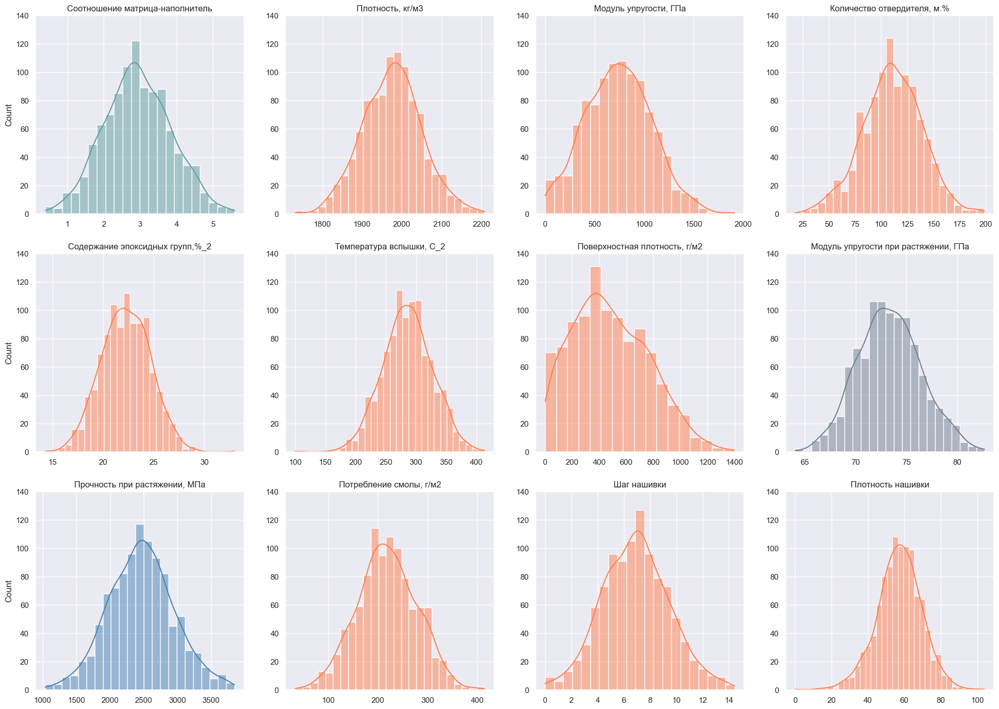

In [26]:
fig, axes = plt.subplots(3, 4, figsize=(24, 17))

n, m = 0, 0
for feature in df_visualization.columns:
    if feature == 'Модуль упругости при растяжении, ГПа':
        hist = sns.histplot(df[feature], kde=True, color='slategray', ax=axes[n, m])
    elif feature == 'Соотношение матрица-наполнитель':
        hist = sns.histplot(df[feature], kde=True, color='cadetblue', ax=axes[n, m])
    elif feature == 'Прочность при растяжении, МПа':
        hist = sns.histplot(df[feature], kde=True, color='steelblue', ax=axes[n, m])
    else:
        hist = sns.histplot(df[feature], color='coral', kde=True, ax=axes[n, m])
    hist.set_ylim(0, 140)
    if m == 0:
        hist.set(xlabel=None, title=feature)
        m += 1
    elif m < 3:
        hist.set(ylabel=None, xlabel=None, title=feature)
        m += 1
    else:
        hist.set(ylabel=None, xlabel=None, title=feature)
        n += 1
        m = 0

Также посмотрю на выбросы по всем характеристикам. 

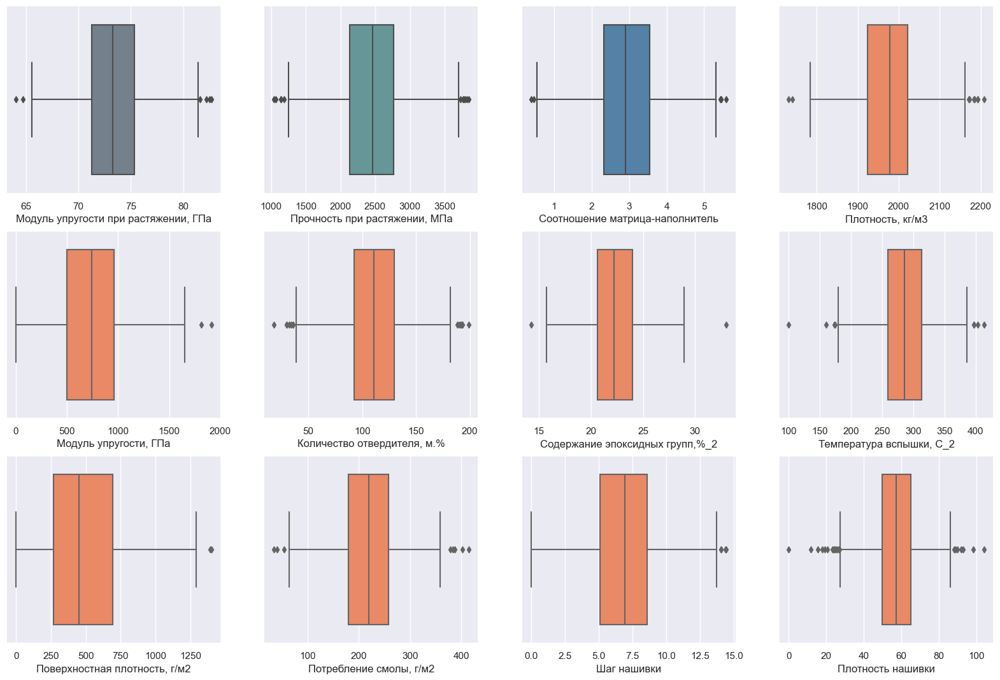

In [27]:
fig, axes = plt.subplots(3, 4, figsize=(20, 13))

sns.boxplot(df['Модуль упругости при растяжении, ГПа'], color='slategray', ax=axes[0, 0])
sns.boxplot(df['Прочность при растяжении, МПа'], color='cadetblue', ax=axes[0, 1]);
sns.boxplot(df['Соотношение матрица-наполнитель'], color='steelblue', ax=axes[0, 2])
sns.boxplot(df['Плотность, кг/м3'], color='coral', ax=axes[0, 3])
sns.boxplot(df['Модуль упругости, ГПа'], color='coral', ax=axes[1, 0])
sns.boxplot(df['Количество отвердителя, м.%'], color='coral', ax=axes[1, 1])
sns.boxplot(df['Содержание эпоксидных групп,%_2'], color='coral', ax=axes[1, 2])
sns.boxplot(df['Температура вспышки, С_2'], color='coral', ax=axes[1, 3])
sns.boxplot(df['Поверхностная плотность, г/м2'], color='coral', ax=axes[2, 0])
sns.boxplot(df['Потребление смолы, г/м2'], color='coral', ax=axes[2, 1])
sns.boxplot(df['Шаг нашивки'], color='coral', ax=axes[2, 2])
sns.boxplot(df['Плотность нашивки'], color='coral', ax=axes[2, 3]);


Вместо визуализации распределения угла нашивки еще раз посмотрю, сколько там уникальных значений и распределены объекты между этими значениями.

In [28]:
df['Угол нашивки, град'].nunique()

2

In [29]:
df['Угол нашивки, град'].value_counts()

0     520
90    503
Name: Угол нашивки, град, dtype: int64

Еще одним вариантом визуализации является попарный график рассеяния. Строю отдельно для обеих целевых переменных (от этого зависит цвет) и общий без разделения.

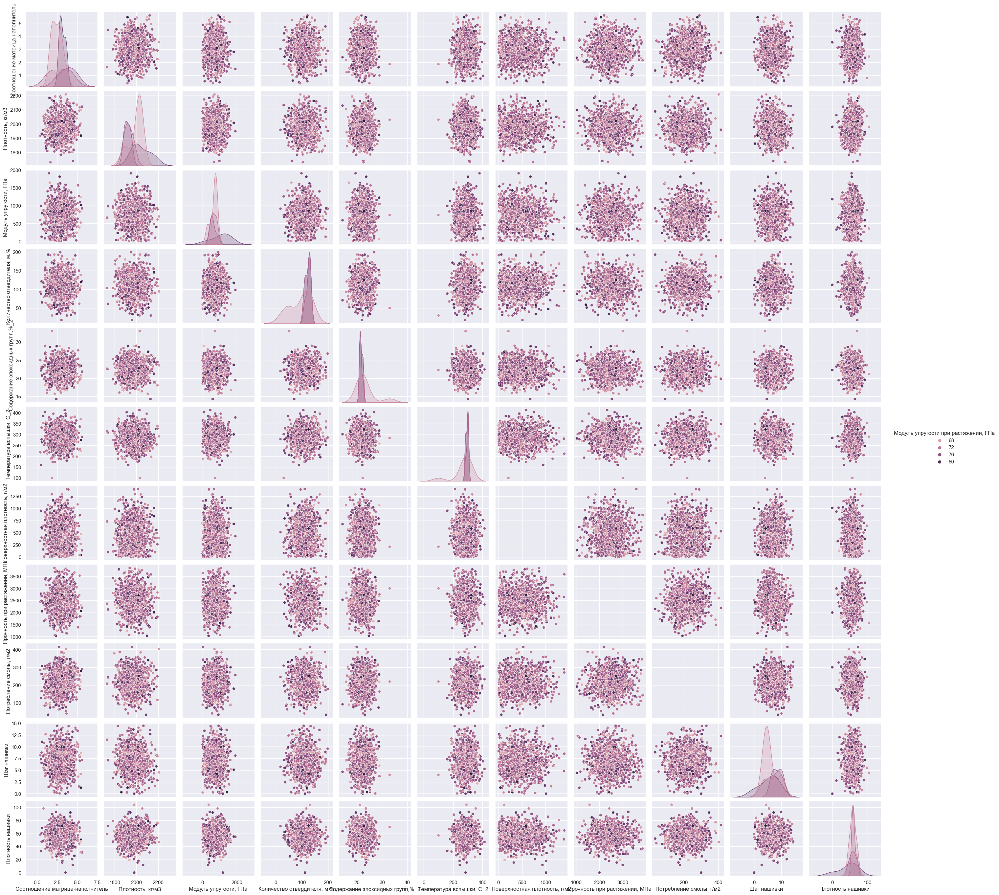

In [30]:
sns.pairplot(df_visualization, hue="Модуль упругости при растяжении, ГПа");

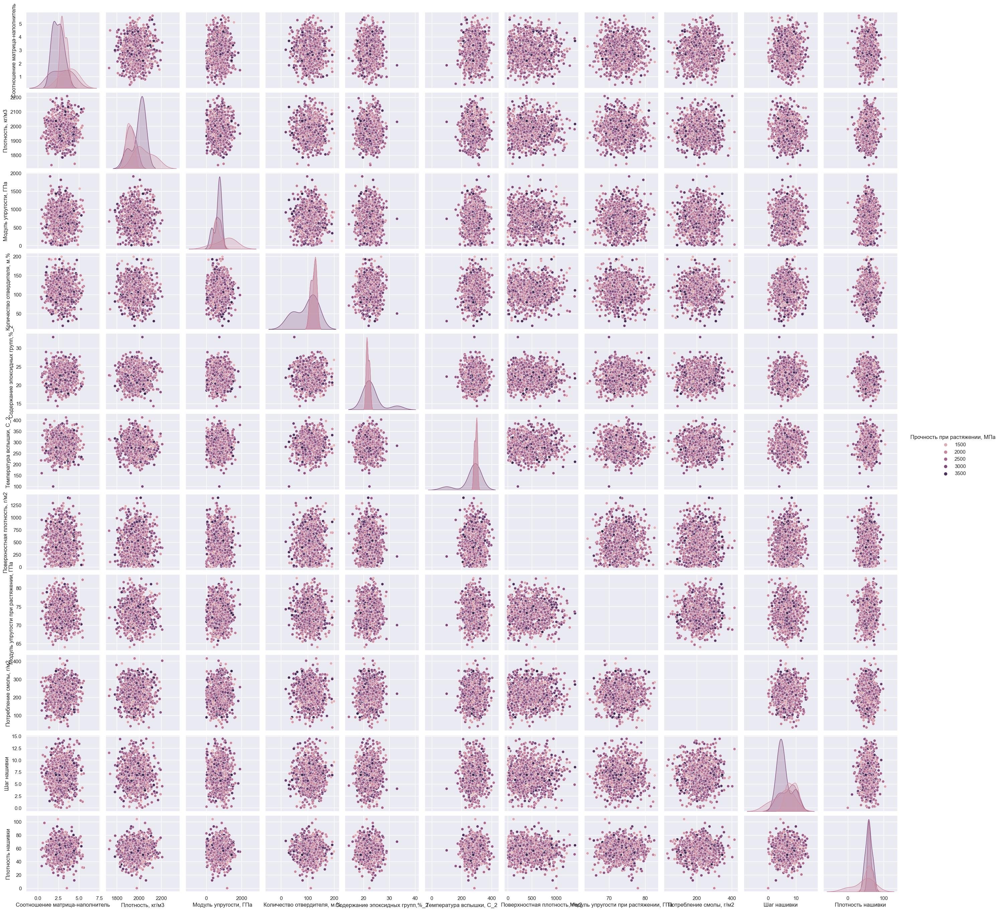

In [31]:
sns.pairplot(df_visualization, hue="Прочность при растяжении, МПа");

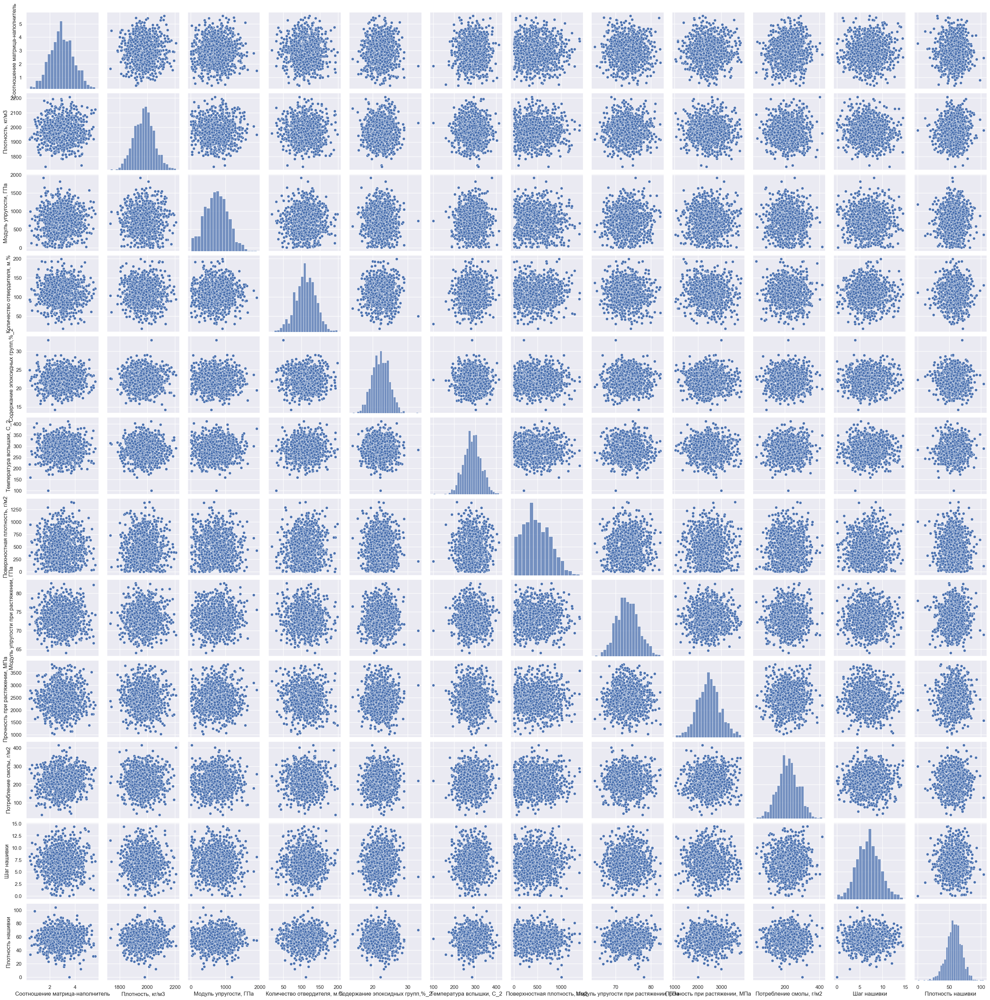

In [32]:
sns.pairplot(df_visualization);

**Вывод**: линейной зависимости не прослеживается. В данных есть выбросы, которые следует обработать. 

# Предобработка данных

## Удаление выбросов в признаках

Для начала скопирую датасет, чтобы не потерять случайно данные. 

In [33]:
df_new = df_no_id.copy()

Далее использую функцию для удаления выбросов по методу межквартильного размаха. После удаления строю графики, чтобы сразу посмотреть, как меняется вид распределения. 

In [34]:
def outlier(df_base, df_new, x):
    quant_75=np.quantile(df_base[x], 0.75)
    quant_25=np.quantile(df_base[x], 0.25)
    IQR = (quant_75 - quant_25) * 1.5

    index1 = df_new[df_new[x] < (quant_25 - IQR)].index
    index2 = df_new[df_new[x] > (quant_75 + IQR)].index
    index = index1.append(index2)
        
    df_new.drop(labels=index, axis=0, inplace=True)
    
    fig, axes = plt.subplots(1, 3, figsize=(15,3))

    sns.histplot(df_base[x], kde=True, ax=axes[0], color='coral')
    axes[0].set_title('С выбросами')
    sns.histplot(df_new[x], kde=True, ax=axes[1], color='coral')
    axes[1].set_title('Без выбросов')
    
    boxplot = sns.boxplot(df_new[x], ax=axes[2], color='coral')
    boxplot.axes.set_title(x)
    boxplot.set_xlabel(x, fontsize=10);
    print(f'Удалено выбросов по признаку "{x}": {len(index)}')

In [35]:
# названия признаков для прохождения по ним циклом
features = list(df_new.columns)

In [36]:
features

['Соотношение матрица-наполнитель',
 'Плотность, кг/м3',
 'Модуль упругости, ГПа',
 'Количество отвердителя, м.%',
 'Содержание эпоксидных групп,%_2',
 'Температура вспышки, С_2',
 'Поверхностная плотность, г/м2',
 'Модуль упругости при растяжении, ГПа',
 'Прочность при растяжении, МПа',
 'Потребление смолы, г/м2',
 'Угол нашивки, град',
 'Шаг нашивки',
 'Плотность нашивки']

In [37]:
features.remove('Соотношение матрица-наполнитель')
features.remove('Модуль упругости при растяжении, ГПа')
features.remove('Прочность при растяжении, МПа')
features.remove('Угол нашивки, град')

In [38]:
features

['Плотность, кг/м3',
 'Модуль упругости, ГПа',
 'Количество отвердителя, м.%',
 'Содержание эпоксидных групп,%_2',
 'Температура вспышки, С_2',
 'Поверхностная плотность, г/м2',
 'Потребление смолы, г/м2',
 'Шаг нашивки',
 'Плотность нашивки']

In [39]:
# Смотрю на количество объектов в датасетах до удаления выбросов
df_new.shape, df.shape

((1023, 13), (1023, 14))

Прохожу циклом по нужным признакам для удаления выбросов

Удалено выбросов по признаку "Плотность, кг/м3": 9
Удалено выбросов по признаку "Модуль упругости, ГПа": 2
Удалено выбросов по признаку "Количество отвердителя, м.%": 14
Удалено выбросов по признаку "Содержание эпоксидных групп,%_2": 2
Удалено выбросов по признаку "Температура вспышки, С_2": 7
Удалено выбросов по признаку "Поверхностная плотность, г/м2": 2
Удалено выбросов по признаку "Потребление смолы, г/м2": 5
Удалено выбросов по признаку "Шаг нашивки": 4
Удалено выбросов по признаку "Плотность нашивки": 21


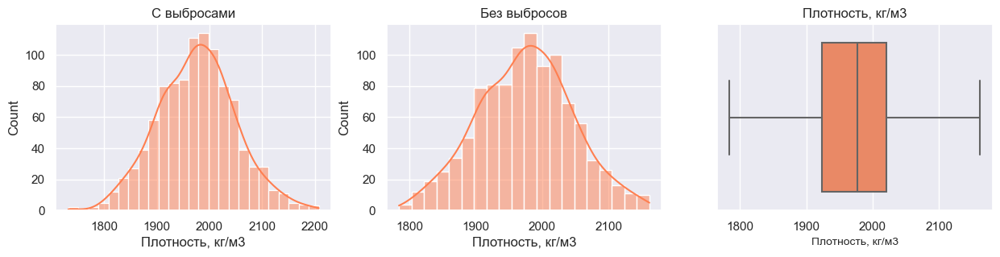

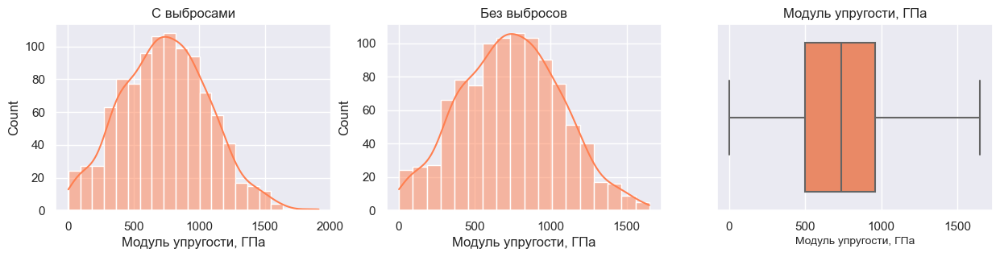

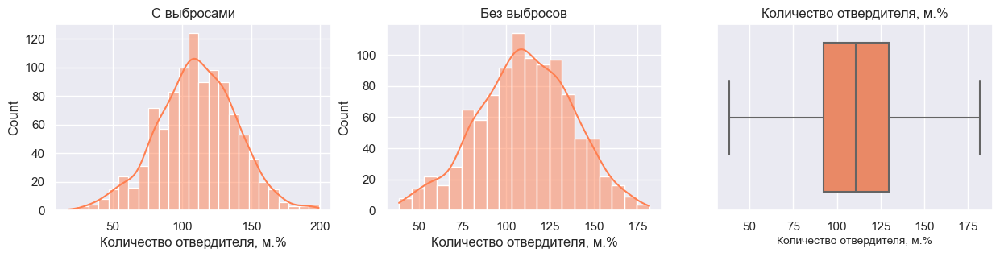

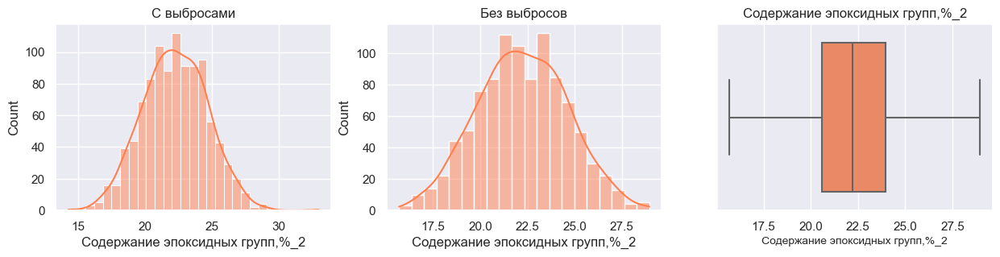

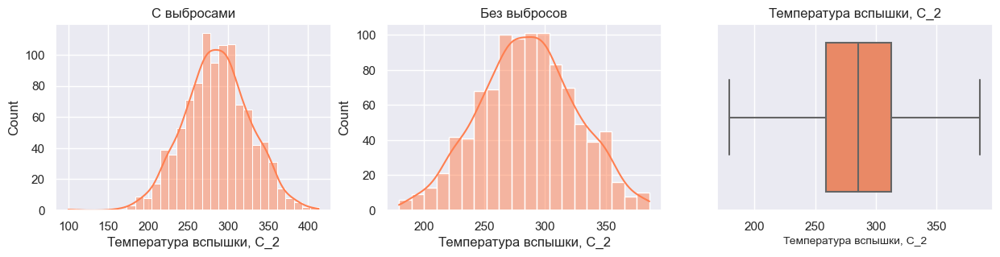

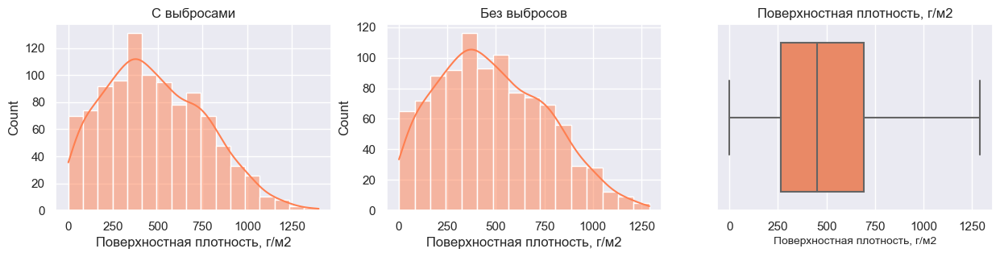

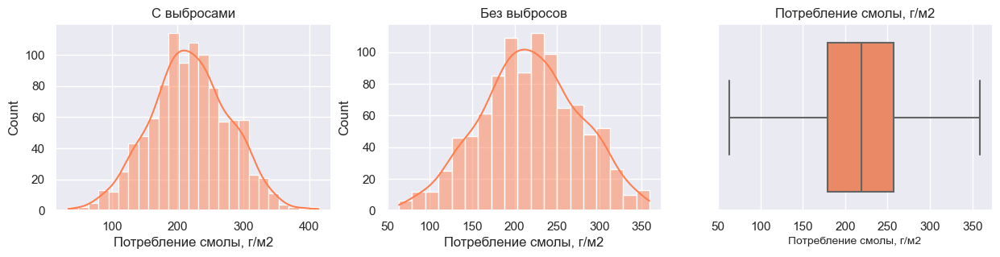

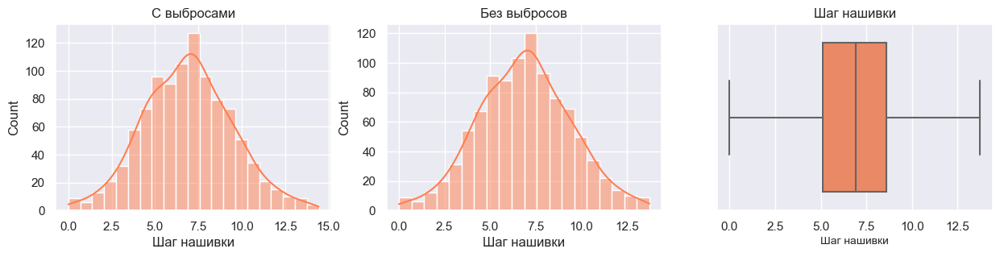

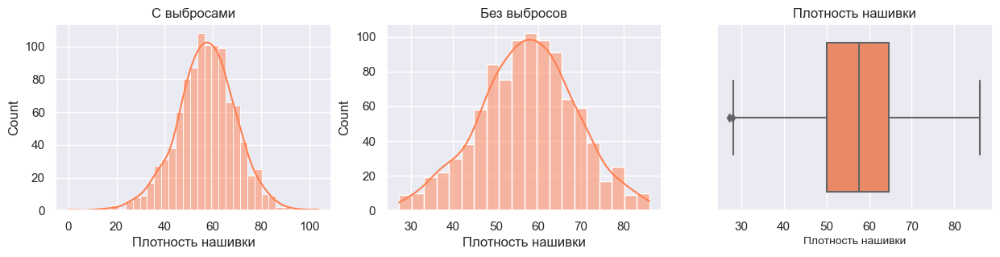

In [40]:
for feature in features:
    outlier(df, df_new, feature)

In [41]:
print(f'Удалено выбросов: {df.shape[0] - df_new.shape[0]}')

Удалено выбросов: 66


In [42]:
outlier_1 = df.shape[0] - df_new.shape[0]

In [43]:
# смотрю, сколько осталось объектов
df_new.shape

(957, 13)

Теперь посмотрю на графики "ящик с усами", чтобы увидеть картину в целом. Заодно посмотреть на целевые переменные: не удалились ли там выбросы вместе с другими объектами. 

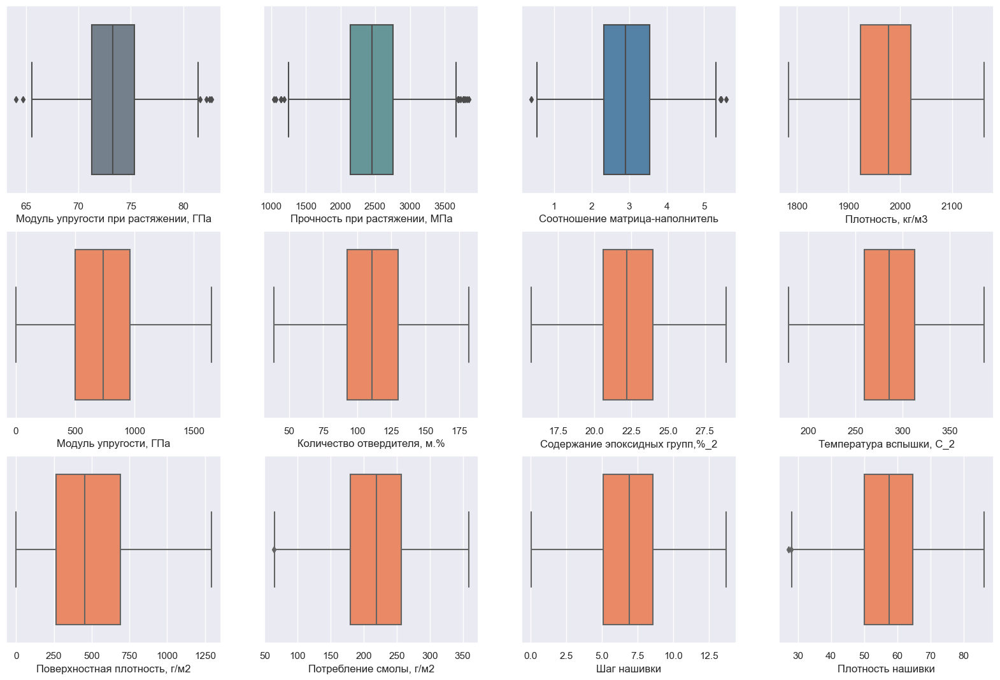

In [44]:
fig, axes = plt.subplots(3, 4, figsize=(20,13))

sns.boxplot(df_new['Модуль упругости при растяжении, ГПа'], color='slategray', ax=axes[0, 0])
sns.boxplot(df_new['Прочность при растяжении, МПа'], color='cadetblue', ax=axes[0, 1]);
sns.boxplot(df_new['Соотношение матрица-наполнитель'], color='steelblue', ax=axes[0, 2])
sns.boxplot(df_new['Плотность, кг/м3'], color='coral', ax=axes[0, 3])
sns.boxplot(df_new['Модуль упругости, ГПа'], color='coral', ax=axes[1, 0])
sns.boxplot(df_new['Количество отвердителя, м.%'], color='coral', ax=axes[1, 1])
sns.boxplot(df_new['Содержание эпоксидных групп,%_2'], color='coral', ax=axes[1, 2])
sns.boxplot(df_new['Температура вспышки, С_2'], color='coral', ax=axes[1, 3])
sns.boxplot(df_new['Поверхностная плотность, г/м2'], color='coral', ax=axes[2, 0])
sns.boxplot(df_new['Потребление смолы, г/м2'], color='coral', ax=axes[2, 1])
sns.boxplot(df_new['Шаг нашивки'], color='coral', ax=axes[2, 2])
sns.boxplot(df_new['Плотность нашивки'], color='coral', ax=axes[2, 3]);

Вижу, что в целевых переменных остались выбросы. Также вижу оставшиеся выбросы в плотности нашивки. Но их удалять уже не буду. Перехожу к целевым переменным. 

## Удаление выбросов в целевых переменных

In [45]:
features = ['Соотношение матрица-наполнитель', 'Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа']

Удалено выбросов по признаку "Соотношение матрица-наполнитель": 5
Удалено выбросов по признаку "Модуль упругости при растяжении, ГПа": 5
Удалено выбросов по признаку "Прочность при растяжении, МПа": 11


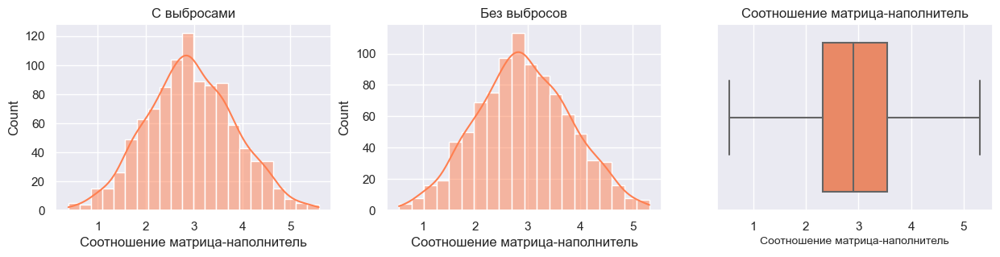

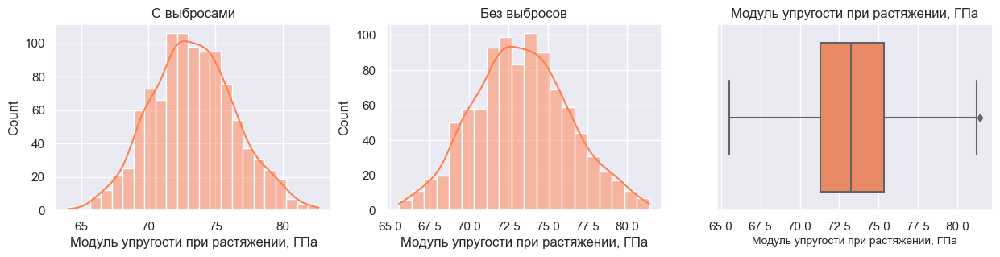

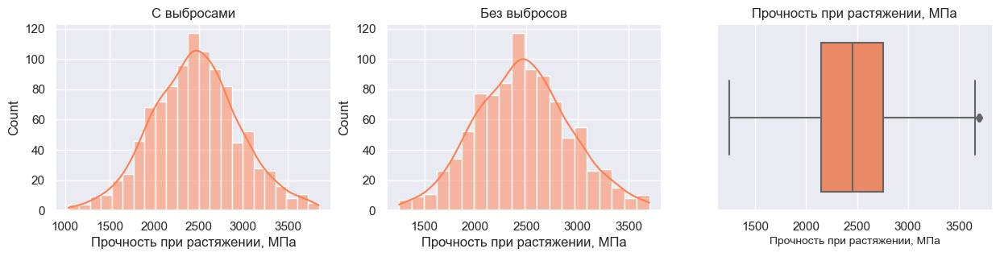

In [46]:
for feature in features:
    outlier(df, df_new, feature)

In [47]:
print(f'Удалено выбросов в целевых переменных: {df.shape[0] - df_new.shape[0] - outlier_1}')

Удалено выбросов в целевых переменных: 21


In [48]:
# сколько осталось значений
df_new.shape

(936, 13)

Еще раз смотрю на "ящики с усами". Вижу, что остается небольшое количество выбросов, т.к. при удалении части строк меняется распределение и выбросами становятся значения, ранее таковыми не являвшиеся. Оставляю их, ориентируясь на первоначальный датасет. 

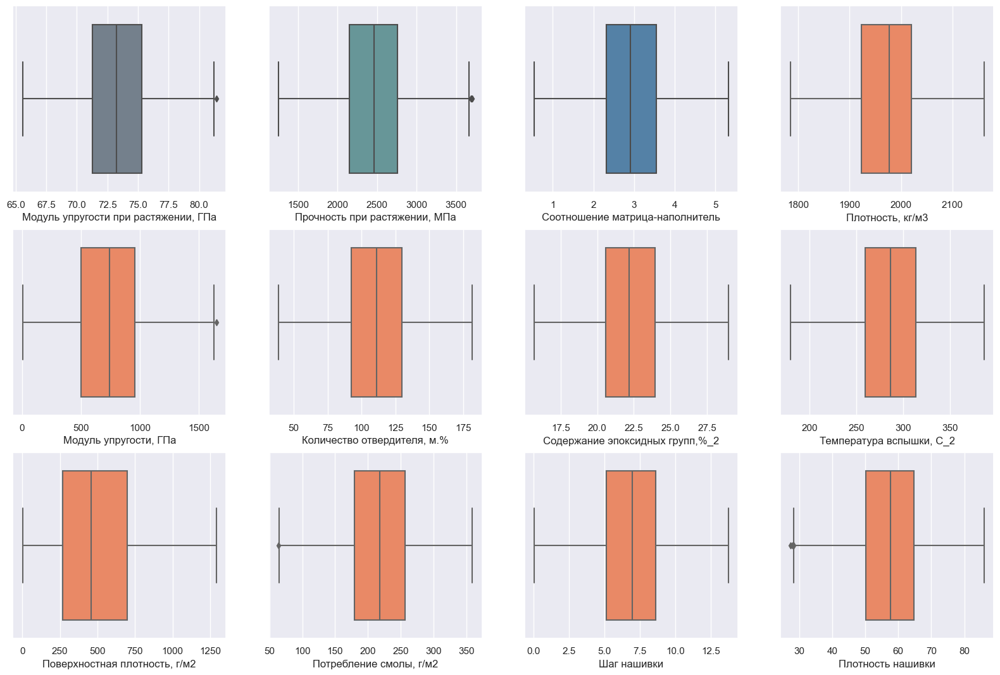

In [49]:
fig, axes = plt.subplots(3, 4, figsize=(20, 13))

sns.boxplot(df_new['Модуль упругости при растяжении, ГПа'], color='slategray', ax=axes[0, 0])
sns.boxplot(df_new['Прочность при растяжении, МПа'], color='cadetblue', ax=axes[0, 1]);
sns.boxplot(df_new['Соотношение матрица-наполнитель'], color='steelblue', ax=axes[0, 2])
sns.boxplot(df_new['Плотность, кг/м3'], color='coral', ax=axes[0, 3])
sns.boxplot(df_new['Модуль упругости, ГПа'], color='coral', ax=axes[1, 0])
sns.boxplot(df_new['Количество отвердителя, м.%'], color='coral', ax=axes[1, 1])
sns.boxplot(df_new['Содержание эпоксидных групп,%_2'], color='coral', ax=axes[1, 2])
sns.boxplot(df_new['Температура вспышки, С_2'], color='coral', ax=axes[1, 3])
sns.boxplot(df_new['Поверхностная плотность, г/м2'], color='coral', ax=axes[2, 0])
sns.boxplot(df_new['Потребление смолы, г/м2'], color='coral', ax=axes[2, 1])
sns.boxplot(df_new['Шаг нашивки'], color='coral', ax=axes[2, 2])
sns.boxplot(df_new['Плотность нашивки'], color='coral', ax=axes[2, 3]);

Можно ради интереса еще раз посмотреть на попарный график рассеяния: как он изменился после удаления выбросов. Вижу, что все стало еще более неопределенным. Набор почти одинаковых пятен. 

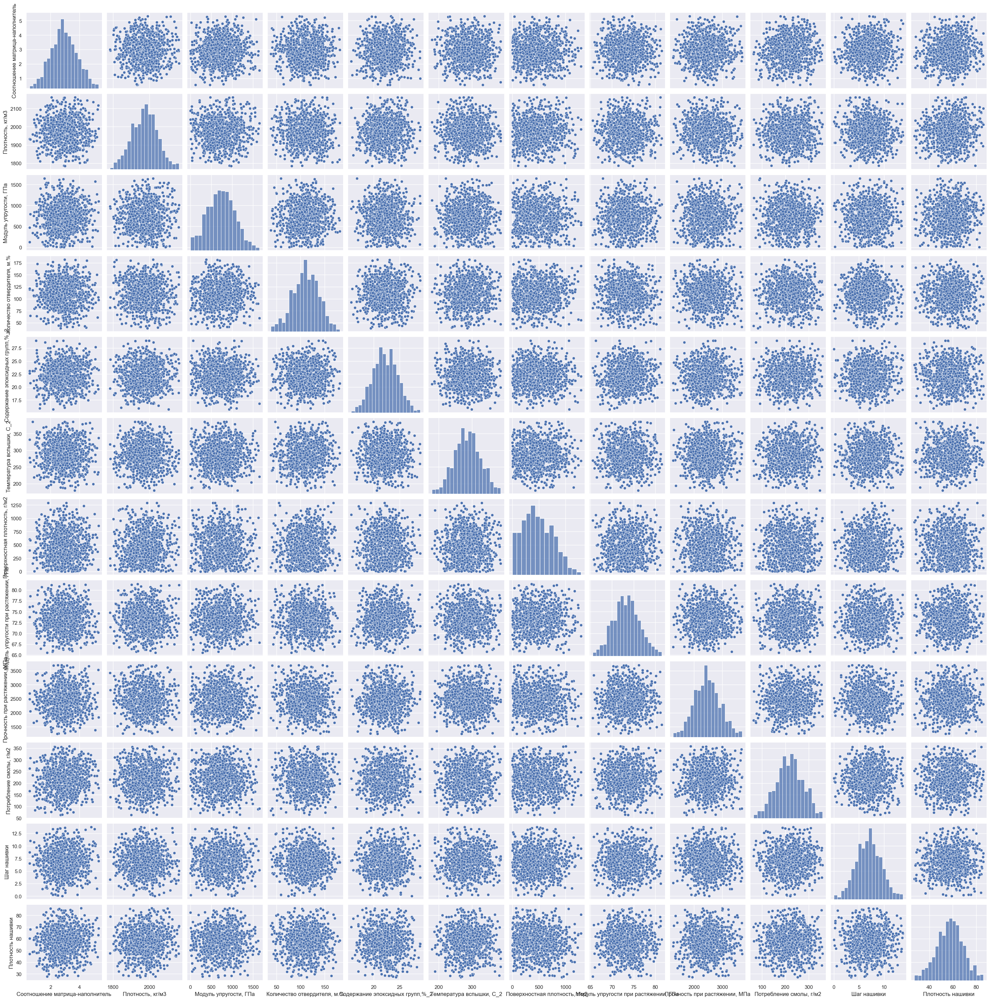

In [50]:
df_visualization_new=df_new.copy()
df_visualization_new.drop(columns=['Угол нашивки, град'], axis=1, inplace=True)
sns.pairplot(df_visualization_new);

## Нормализация и разбиение на выборки

Буду проводить нормализацию методом MinMaxScaler. Нормализацию провожу до разбиения на выборки. Scaler сохраняю в переменные (для X и y отдельно), чтобы затем сохранить эти модели для приложения. 

In [51]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

In [52]:
X = df_new.copy()
y_columns = ['Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа']
y = X[y_columns]
X.drop(columns = y_columns, axis=1, inplace=True)

In [53]:
minmax_X = MinMaxScaler()
X_norm = minmax_X.fit_transform(X)
X_norm = pd.DataFrame(X_norm, columns= X.columns)
X_norm.describe().T # проверяю, что нормализация прошла успешно: минимальное значение 0, максимальное 1. 

,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,936.0,0.498933,0.187489,0.0,0.372274,0.494538,0.629204,1.0
"Плотность, кг/м3",936.0,0.502695,0.187779,0.0,0.368517,0.511229,0.624999,1.0
"Модуль упругости, ГПа",936.0,0.446764,0.199583,0.0,0.301243,0.447061,0.580446,1.0
"Количество отвердителя, м.%",936.0,0.504664,0.188865,0.0,0.376190,0.506040,0.637978,1.0
"Содержание эпоксидных групп,%_2",936.0,0.491216,0.180620,0.0,0.367716,0.489382,0.623410,1.0
"Температура вспышки, С_2",936.0,0.516059,0.190624,0.0,0.386128,0.515980,0.646450,1.0
"Поверхностная плотность, г/м2",936.0,0.373733,0.217078,0.0,0.205619,0.354161,0.538683,1.0
"Потребление смолы, г/м2",936.0,0.521141,0.195781,0.0,0.392067,0.523766,0.652447,1.0
"Угол нашивки, град",936.0,0.511752,0.500129,0.0,0.000000,1.000000,1.000000,1.0
Шаг нашивки,936.0,0.502232,0.183258,0.0,0.372211,0.504258,0.624604,1.0


In [54]:
minmax_y = MinMaxScaler()
y_norm = minmax_y.fit_transform(y)
y_norm = pd.DataFrame(y_norm, columns= y.columns)
y_norm.describe().T

,count,mean,std,min,25%,50%,75%,max
"Модуль упругости при растяжении, ГПа",936.0,0.488647,0.191466,0.0,0.359024,0.485754,0.615077,1.0
"Прочность при растяжении, МПа",936.0,0.495706,0.188915,0.0,0.365149,0.491825,0.612874,1.0


In [55]:
# проверяю работу inverse_transform для дальнейшей работы с приложением и расчета метрик
y_inversed = minmax_y.inverse_transform(y_norm)
y_inversed = pd.DataFrame(y_inversed, columns=y.columns)
y_inversed.describe().T

,count,mean,std,min,25%,50%,75%,max
"Модуль упругости при растяжении, ГПа",936.0,73.305127,3.037381,65.553336,71.248823,73.259230,75.310788,81.417126
"Прочность при растяжении, МПа",936.0,2467.488822,463.838911,1250.392802,2146.936034,2457.959767,2755.169485,3705.672523


In [56]:
# проверяю работу inverse_transform
X_inversed = minmax_X.inverse_transform(X_norm)
X_inversed = pd.DataFrame(X_inversed, columns=X.columns)
X_inversed.describe().T

,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,936.0,2.925683,0.893712,0.547391,2.321931,2.904731,3.546650,5.314144
"Плотность, кг/м3",936.0,1974.040023,70.808120,1784.482245,1923.443748,1977.258043,2020.158764,2161.565216
"Модуль упругости, ГПа",936.0,738.247627,328.708665,2.436909,498.577158,738.736842,958.418993,1649.415706
"Количество отвердителя, м.%",936.0,110.916216,27.037891,38.668500,92.523816,111.113175,130.001450,181.828448
"Содержание эпоксидных групп,%_2",936.0,22.209030,2.394871,15.695894,20.571516,22.184713,23.961818,28.955094
"Температура вспышки, С_2",936.0,286.040414,39.400677,179.374391,259.184486,286.024118,312.991425,386.067992
"Поверхностная плотность, г/м2",936.0,482.993901,280.190377,0.603740,266.004099,457.732246,695.900862,1291.340115
"Потребление смолы, г/м2",936.0,217.613374,57.827255,63.685698,179.489091,218.388715,256.396777,359.052220
"Угол нашивки, град",936.0,46.057692,45.011619,0.000000,0.000000,90.000000,90.000000,90.000000
Шаг нашивки,936.0,6.915585,2.509672,0.037639,5.134988,6.943337,8.591450,13.732404


Разделяю датасет на выборки.

In [57]:
X_train, X_test, y_train, y_test = train_test_split(X_norm, y_norm, train_size=0.7, random_state=8)

____

Далее несколько шагов делаю для сохранения модели и тестирования приложения.

In [58]:
X_test_reg = minmax_X.inverse_transform(X_test.values)

In [59]:
X_columns_reg = X.columns
X_columns_reg

Index(['Соотношение матрица-наполнитель', 'Плотность, кг/м3',
       'Модуль упругости, ГПа', 'Количество отвердителя, м.%',
       'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2',
       'Поверхностная плотность, г/м2', 'Потребление смолы, г/м2',
       'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки'],
      dtype='object')

# Обучение моделей

Чтобы от чего-то отталкиваться при выборе модели, выбираю тактику, предложенную в документации sklearn. 

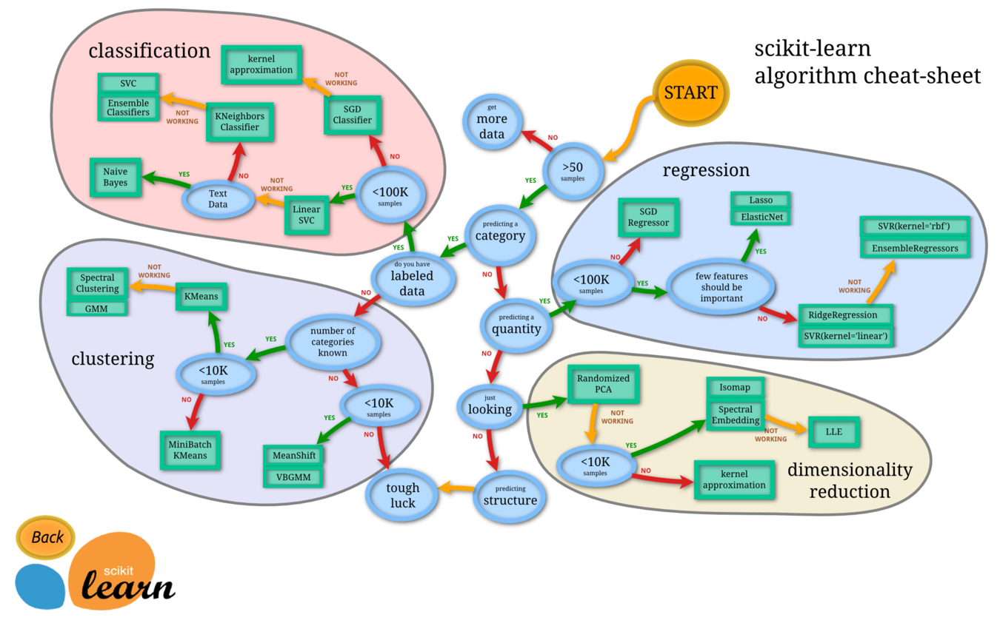

Но для начала обучу базовую модель, с которой будет вестись сравнение. 

In [60]:
from sklearn.dummy import DummyRegressor
from sklearn.metrics import mean_absolute_error, r2_score

In [61]:
dummy = DummyRegressor(strategy='median') # беру median, потому что при mean очень маленькие значения для r2_score
result = dummy.fit(X_train, y_train)

Напишу функцию для расчета метрик и добавления их в таблицу для сравнения.

In [62]:
df_metrics = pd.DataFrame(columns=['Название модели', 'Метрика', 'Выборка', 'Модуль упругости при растяжении, ГПа', 
                                   'Прочность при растяжении, МПа'])

In [63]:
def metrics(model_name, result, X_train, X_test, y_train, y_test, df_metrics):
    y_train_predict = result.predict(X_train)
    y_test_predict = result.predict(X_test)
    y_train_predict = minmax_y.inverse_transform(y_train_predict)
    y_test_predict = minmax_y.inverse_transform(y_test_predict)
    y_train = minmax_y.inverse_transform(y_train)
    y_test = minmax_y.inverse_transform(y_test)
    
    mae_train_target1 = mean_absolute_error(y_train[:,0], y_train_predict[:,0])
    mae_test_target1 = mean_absolute_error(y_test[:,0], y_test_predict[:,0])
    r2_score_train_target1 = r2_score(y_train[:,0], y_train_predict[:,0])
    r2_score_test_target1 = r2_score(y_test[:,0], y_test_predict[:,0])
    
    mae_train_target2 = mean_absolute_error(y_train[:,1], y_train_predict[:,1]) 
    mae_test_target2 = mean_absolute_error(y_test[:,1], y_test_predict[:,1])
    r2_score_train_target2 = r2_score(y_train[:,1], y_train_predict[:,1])
    r2_score_test_target2 = r2_score(y_test[:,1], y_test_predict[:,1])
          
    df_metrics.loc[len(df_metrics.index)] = [model_name, 'MAE', 'train', mae_train_target1, mae_train_target2]
    df_metrics.loc[len(df_metrics.index)] = [model_name, 'MAE', 'test', mae_test_target1, mae_test_target2]
    df_metrics.loc[len(df_metrics.index)] = [model_name, 'R2_score', 'train', r2_score_train_target1, r2_score_train_target2]
    df_metrics.loc[len(df_metrics.index)] = [model_name, 'R2_score', 'test', r2_score_test_target1, r2_score_test_target2]
    
    return df_metrics.loc[len(df_metrics.index)-4:len(df_metrics.index)-1]

In [64]:
metrics('Dummy Regression', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
0,Dummy Regression,MAE,train,2.482294,370.151613
1,Dummy Regression,MAE,test,2.369521,365.233533
2,Dummy Regression,R2_score,train,-0.000422,-0.001748
3,Dummy Regression,R2_score,test,-0.000081,-0.001275


## Linear Regression

Попробую также линейную регрессию. Скорее всего не сработает, т.к. нет корреляции между признаками и целевыми переменными. 

In [65]:
from sklearn.linear_model import LinearRegression

In [66]:
linregr = LinearRegression()
result = linregr.fit(X_train, y_train)

In [67]:
result.coef_, result.intercept_

(array([[-0.027, -0.052,  0.04 , -0.066,  0.05 ,  0.004,  0.025,  0.059,
          0.007, -0.051,  0.033],
        [ 0.018, -0.064,  0.027, -0.029, -0.022,  0.025, -0.043,  0.026,
          0.018, -0.069, -0.009]]),
 array([0.484, 0.553]))

In [68]:
metrics('Linear Regression', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
4,Linear Regression,MAE,train,2.471429,367.907814
5,Linear Regression,MAE,test,2.382793,365.219629
6,Linear Regression,R2_score,train,0.017266,0.015682
7,Linear Regression,R2_score,test,-0.009817,0.009514


## Ridge Regression

Далее попробую пойти по пути, предложенному в документации sklearn. 
Хотя уже понятно, что линейная регрессия не работает. 

Пробую Ridge. Если alpha=.0, то результат будет ровно такой же, как в линейной регрессии. При увеличении alpha метрики модели практически не меняются. 

In [69]:
from sklearn.linear_model import Ridge

In [70]:
ridgeregr = Ridge(alpha=.5)
result = ridgeregr.fit(X_train, y_train)

In [71]:
metrics('Ridge Regression', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
8,Ridge Regression,MAE,train,2.471299,367.908740
9,Ridge Regression,MAE,test,2.382002,365.156073
10,Ridge Regression,R2_score,train,0.017256,0.015675
11,Ridge Regression,R2_score,test,-0.009089,0.009512


## SVR

In [72]:
from sklearn.svm import SVR
from sklearn.multioutput import MultiOutputRegressor

In [73]:
regr = MultiOutputRegressor(SVR(kernel='linear'))
result = regr.fit(X_train, y_train)

In [74]:
metrics('SVR (kernel = linear)', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
12,SVR (kernel = linear),MAE,train,2.471193,368.661835
13,SVR (kernel = linear),MAE,test,2.371413,364.265574
14,SVR (kernel = linear),R2_score,train,0.013286,0.009365
15,SVR (kernel = linear),R2_score,test,0.000256,0.011291


Попробую kernel = 'rbf'.

In [75]:
regr_svr = MultiOutputRegressor(SVR(kernel='rbf'))
result = regr_svr.fit(X_train, y_train)

In [76]:
metrics('SVR (kernel = rbf)', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
16,SVR (kernel = rbf),MAE,train,1.831728,275.056951
17,SVR (kernel = rbf),MAE,test,2.630848,384.266121
18,SVR (kernel = rbf),R2_score,train,0.451550,0.441996
19,SVR (kernel = rbf),R2_score,test,-0.230286,-0.127720


Прежде чем приступать к ансамблевым методам попробую всё же нелинейную регрессию. 

## KNN

In [77]:
from sklearn.neighbors import KNeighborsRegressor

In [78]:
n_neighbors = 50
knn = KNeighborsRegressor(n_neighbors=n_neighbors)
result = knn.fit(X_train, y_train)

In [79]:
metrics('KNN (n_neighbors = 50)', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
20,KNN (n_neighbors = 50),MAE,train,2.457078,368.230739
21,KNN (n_neighbors = 50),MAE,test,2.377729,370.473259
22,KNN (n_neighbors = 50),R2_score,train,0.022525,0.018979
23,KNN (n_neighbors = 50),R2_score,test,-0.006884,-0.013846


Пройдусь по сетке для выбора гиперпараметров. 

In [80]:
from sklearn.model_selection import GridSearchCV

In [81]:
param = {
    'n_neighbors': [5, 10, 15, 20, 25],
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']
}

In [82]:
model = GridSearchCV(KNeighborsRegressor(), param, cv=10)
model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=KNeighborsRegressor(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'n_neighbors': [5, 10, 15, 20, 25],
                         'weights': ['uniform', 'distance']})

In [83]:
model.best_params_

{'algorithm': 'auto', 'n_neighbors': 25, 'weights': 'uniform'}

In [84]:
result = model.best_estimator_
result

KNeighborsRegressor(n_neighbors=25)

In [85]:
metrics('KNN (GridSearch)', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
24,KNN (GridSearch),MAE,train,2.431687,366.124236
25,KNN (GridSearch),MAE,test,2.419037,373.996179
26,KNN (GridSearch),R2_score,train,0.041780,0.028709
27,KNN (GridSearch),R2_score,test,-0.038480,-0.037384


## Decision Tree Regressor

In [86]:
from sklearn.tree import DecisionTreeRegressor
decisiontree = DecisionTreeRegressor()
result = decisiontree.fit(X_train, y_train)

In [87]:
metrics('DecisionTree', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
28,DecisionTree,MAE,train,0.000000,0.000000
29,DecisionTree,MAE,test,3.228358,517.156764
30,DecisionTree,R2_score,train,1.000000,1.000000
31,DecisionTree,R2_score,test,-0.873976,-1.002230


Деревья склонны к переобучению. Поэтому можно поставить ограничение максимальной глубины и посмотреть, что будет. 

In [88]:
decisiontree = DecisionTreeRegressor(max_depth=5)
result = decisiontree.fit(X_train, y_train)

In [89]:
metrics('DecisionTree (max_depth=5)', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
32,DecisionTree (max_depth=5),MAE,train,2.222325,343.436820
33,DecisionTree (max_depth=5),MAE,test,2.517028,381.520860
34,DecisionTree (max_depth=5),R2_score,train,0.154262,0.120696
35,DecisionTree (max_depth=5),R2_score,test,-0.109200,-0.068779


In [90]:
decisiontree = DecisionTreeRegressor(max_depth=10)
result = decisiontree.fit(X_train, y_train)

In [91]:
metrics('DecisionTree (max_depth=10)', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
36,DecisionTree (max_depth=10),MAE,train,1.221867,195.339904
37,DecisionTree (max_depth=10),MAE,test,3.053843,458.361581
38,DecisionTree (max_depth=10),R2_score,train,0.616051,0.585051
39,DecisionTree (max_depth=10),R2_score,test,-0.746662,-0.580206


Можно также произвести поиск по сетке для лучших параметров. 

In [92]:
param = {
    'criterion': ["squared_error", "friedman_mse", "absolute_error", "poisson"],
    
    'max_depth': [3, 4, 5, 10],
    'min_samples_split': [2, 4, 8, 16, 32],  
}

In [93]:
model = GridSearchCV(DecisionTreeRegressor(), param, cv=10)
model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=DecisionTreeRegressor(),
             param_grid={'criterion': ['squared_error', 'friedman_mse',
                                       'absolute_error', 'poisson'],
                         'max_depth': [3, 4, 5, 10],
                         'min_samples_split': [2, 4, 8, 16, 32]})

In [94]:
model.best_params_

{'criterion': 'poisson', 'max_depth': 3, 'min_samples_split': 16}

In [95]:
result = model.best_estimator_

In [96]:
metrics('DecisionTree (GridSearch)', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
40,DecisionTree (GridSearch),MAE,train,2.421463,365.501349
41,DecisionTree (GridSearch),MAE,test,2.360313,372.671585
42,DecisionTree (GridSearch),R2_score,train,0.041414,0.046659
43,DecisionTree (GridSearch),R2_score,test,-0.011842,-0.048376


## Random Forest

Перехожу к ансамблевым методам. 

In [97]:
from sklearn.ensemble import RandomForestRegressor

In [98]:
r_forest = RandomForestRegressor()
result = r_forest.fit(X_train, y_train)

In [99]:
metrics('Random Forest', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
44,Random Forest,MAE,train,0.938030,141.044603
45,Random Forest,MAE,test,2.435886,370.123178
46,Random Forest,R2_score,train,0.853281,0.856817
47,Random Forest,R2_score,test,-0.064616,-0.026683


## AdaBoost

In [100]:
from sklearn.ensemble import AdaBoostRegressor

In [101]:
regr = MultiOutputRegressor(AdaBoostRegressor(random_state=0, n_estimators=80, loss='square'))
result=regr.fit(X_train, y_train)

In [102]:
metrics('AdaBoost', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
48,AdaBoost,MAE,train,2.354339,350.223915
49,AdaBoost,MAE,test,2.476820,364.582333
50,AdaBoost,R2_score,train,0.191939,0.202173
51,AdaBoost,R2_score,test,-0.123005,-0.034311


## Stacking Regressor

In [103]:
from sklearn.ensemble import StackingRegressor

In [104]:
estimators = [
    ('rf', RandomForestRegressor()),
    ('svr', SVR(kernel='rbf'))
]

model = MultiOutputRegressor(StackingRegressor(
    estimators=estimators, 
    final_estimator = RandomForestRegressor()
))

model.fit(X_train, y_train)

MultiOutputRegressor(estimator=StackingRegressor(estimators=[('rf',
                                                              RandomForestRegressor()),
                                                             ('svr', SVR())],
                                                 final_estimator=RandomForestRegressor()))

In [105]:
metrics('StackingRegressor', result, X_train, X_test, y_train, y_test, df_metrics)

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
52,StackingRegressor,MAE,train,2.354339,350.223915
53,StackingRegressor,MAE,test,2.476820,364.582333
54,StackingRegressor,R2_score,train,0.191939,0.202173
55,StackingRegressor,R2_score,test,-0.123005,-0.034311


## Сравнение моделей

Посмотрю на метрики в различных разрезах

In [106]:
df_metrics[df_metrics.Метрика == 'MAE']

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
0,Dummy Regression,MAE,train,2.482294,370.151613
1,Dummy Regression,MAE,test,2.369521,365.233533
4,Linear Regression,MAE,train,2.471429,367.907814
5,Linear Regression,MAE,test,2.382793,365.219629
8,Ridge Regression,MAE,train,2.471299,367.908740
9,Ridge Regression,MAE,test,2.382002,365.156073
12,SVR (kernel = linear),MAE,train,2.471193,368.661835
13,SVR (kernel = linear),MAE,test,2.371413,364.265574
16,SVR (kernel = rbf),MAE,train,1.831728,275.056951
17,SVR (kernel = rbf),MAE,test,2.630848,384.266121


In [107]:
df_metrics[df_metrics.Метрика == 'R2_score']

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа"
2,Dummy Regression,R2_score,train,-0.000422,-0.001748
3,Dummy Regression,R2_score,test,-0.000081,-0.001275
6,Linear Regression,R2_score,train,0.017266,0.015682
7,Linear Regression,R2_score,test,-0.009817,0.009514
10,Ridge Regression,R2_score,train,0.017256,0.015675
11,Ridge Regression,R2_score,test,-0.009089,0.009512
14,SVR (kernel = linear),R2_score,train,0.013286,0.009365
15,SVR (kernel = linear),R2_score,test,0.000256,0.011291
18,SVR (kernel = rbf),R2_score,train,0.451550,0.441996
19,SVR (kernel = rbf),R2_score,test,-0.230286,-0.127720


Отсортирую по возрастанию значения MAE для каждой целевой переменной.

In [108]:
df_mae_1 = df_metrics[df_metrics.Выборка == 'test'][df_metrics.Метрика == 'MAE']\
.sort_values(by='Модуль упругости при растяжении, ГПа', ascending=True)
df_mae_1[['Название модели', 'Метрика', 'Выборка', 'Модуль упругости при растяжении, ГПа']]

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа"
41,DecisionTree (GridSearch),MAE,test,2.360313
1,Dummy Regression,MAE,test,2.369521
13,SVR (kernel = linear),MAE,test,2.371413
21,KNN (n_neighbors = 50),MAE,test,2.377729
9,Ridge Regression,MAE,test,2.382002
5,Linear Regression,MAE,test,2.382793
25,KNN (GridSearch),MAE,test,2.419037
45,Random Forest,MAE,test,2.435886
49,AdaBoost,MAE,test,2.476820
53,StackingRegressor,MAE,test,2.476820


In [109]:
df_mae_2 = df_metrics[df_metrics.Выборка == 'test'][df_metrics.Метрика == 'MAE']\
.sort_values(by='Прочность при растяжении, МПа', ascending=True)
df_mae_2[['Название модели', 'Метрика', 'Выборка', 'Прочность при растяжении, МПа']]

,Название модели,Метрика,Выборка,"Прочность при растяжении, МПа"
13,SVR (kernel = linear),MAE,test,364.265574
49,AdaBoost,MAE,test,364.582333
53,StackingRegressor,MAE,test,364.582333
9,Ridge Regression,MAE,test,365.156073
5,Linear Regression,MAE,test,365.219629
1,Dummy Regression,MAE,test,365.233533
45,Random Forest,MAE,test,370.123178
21,KNN (n_neighbors = 50),MAE,test,370.473259
41,DecisionTree (GridSearch),MAE,test,372.671585
25,KNN (GridSearch),MAE,test,373.996179


Отсортирую по убыванию значения R2_score для каждой целевой переменной. 

In [110]:
df_r2_1=df_metrics[df_metrics.Выборка == 'test'][df_metrics.Метрика == 'R2_score']\
.sort_values(by='Модуль упругости при растяжении, ГПа', ascending=False)
df_r2_1[['Название модели', 'Метрика', 'Выборка', 'Модуль упругости при растяжении, ГПа']]

,Название модели,Метрика,Выборка,"Модуль упругости при растяжении, ГПа"
15,SVR (kernel = linear),R2_score,test,0.000256
3,Dummy Regression,R2_score,test,-0.000081
23,KNN (n_neighbors = 50),R2_score,test,-0.006884
11,Ridge Regression,R2_score,test,-0.009089
7,Linear Regression,R2_score,test,-0.009817
43,DecisionTree (GridSearch),R2_score,test,-0.011842
27,KNN (GridSearch),R2_score,test,-0.038480
47,Random Forest,R2_score,test,-0.064616
35,DecisionTree (max_depth=5),R2_score,test,-0.109200
51,AdaBoost,R2_score,test,-0.123005


In [111]:
df_r2_2=df_metrics[df_metrics.Выборка == 'test'][df_metrics.Метрика == 'R2_score']\
.sort_values(by='Прочность при растяжении, МПа', ascending=False)
df_r2_2[['Название модели', 'Метрика', 'Выборка', 'Прочность при растяжении, МПа']]

,Название модели,Метрика,Выборка,"Прочность при растяжении, МПа"
15,SVR (kernel = linear),R2_score,test,0.011291
7,Linear Regression,R2_score,test,0.009514
11,Ridge Regression,R2_score,test,0.009512
3,Dummy Regression,R2_score,test,-0.001275
23,KNN (n_neighbors = 50),R2_score,test,-0.013846
47,Random Forest,R2_score,test,-0.026683
51,AdaBoost,R2_score,test,-0.034311
55,StackingRegressor,R2_score,test,-0.034311
27,KNN (GridSearch),R2_score,test,-0.037384
43,DecisionTree (GridSearch),R2_score,test,-0.048376


# Нейросеть

In [112]:
import tensorflow as tf
from tensorflow import keras

from keras.models import Sequential
from keras.layers import Normalization, Dense, Dropout
from keras import callbacks

Не буду проводить нормализацию заранее, добавлю слой Normalization. Разделяю на X и y, сразу преобразовав их в np.array.

In [113]:
X = df_new.copy()
y = X['Соотношение матрица-наполнитель']
X.drop(columns = ['Соотношение матрица-наполнитель'], axis=1, inplace=True)
X_columns_nn = X.columns # это для дальнейшей работы с приложением
X = X.values
y = y.values

In [114]:
normalizer = Normalization(axis=-1)
normalizer.adapt(X)

In [115]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, random_state=8)

## Модель 1

Для начала попробую простой вариант, количество нейронов на первом скрытом слое равно количеству входов.  

In [116]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=12, activation='relu'))
model.add(Dense(units=32, activation='relu'))
model.add(Dense(units=1))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense (Dense)               (None, 12)                156       
                                                                 
 dense_1 (Dense)             (None, 32)                416       
                                                                 
 dense_2 (Dense)             (None, 1)                 33        
                                                                 
Total params: 630
Trainable params: 605
Non-trainable params: 25
_________________________________________________________________


In [117]:
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

In [118]:
early_stop = callbacks.EarlyStopping(monitor='val_loss',
                                     min_delta=0.0005,
                                     patience=10,
                                     verbose=1,
                                     mode='auto',
                                     restore_best_weights=True)

In [119]:
# использую в первых трех моделях
save_model = callbacks.ModelCheckpoint(filepath="models/best_model_{epoch}.hdf5", 
                                       monitor='val_loss', 
                                       verbose=1,
                                       save_best_only=True, 
                                       mode='auto', 
                                       save_freq='epoch')

In [120]:
n_epochs = 100

In [121]:
history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop, save_model])

Epoch 1/100
18/21 [========================>.....] - ETA: 0s - loss: 9.3430 - mae: 2.9073  
Epoch 1: val_loss improved from inf to 7.62879, saving model to models\best_model_1.hdf5
21/21 [==============================] - 2s 30ms/step - loss: 9.0171 - mae: 2.8493 - val_loss: 7.6288 - val_mae: 2.5935
Epoch 2/100
15/21 [====================>.........] - ETA: 0s - loss: 6.4021 - mae: 2.3504
Epoch 2: val_loss improved from 7.62879 to 5.27717, saving model to models\best_model_2.hdf5
21/21 [==============================] - 0s 11ms/step - loss: 6.3205 - mae: 2.3214 - val_loss: 5.2772 - val_mae: 2.0735
Epoch 3/100
13/21 [=================>............] - ETA: 0s - loss: 4.5619 - mae: 1.8926
Epoch 3: val_loss improved from 5.27717 to 3.54805, saving model to models\best_model_3.hdf5
21/21 [==============================] - 0s 12ms/step - loss: 4.2971 - mae: 1.8161 - val_loss: 3.5481 - val_mae: 1.6100
Epoch 4/100
11/21 [==============>...............] - ETA: 0s - loss: 3.0760 - mae: 1.4728
Epo

Epoch 28/100
21/21 [==============================] - ETA: 0s - loss: 0.8685 - mae: 0.7558
Epoch 28: val_loss improved from 0.93918 to 0.93108, saving model to models\best_model_28.hdf5
21/21 [==============================] - 0s 15ms/step - loss: 0.8685 - mae: 0.7558 - val_loss: 0.9311 - val_mae: 0.7723
Epoch 29/100
21/21 [==============================] - ETA: 0s - loss: 0.8600 - mae: 0.7520
Epoch 29: val_loss improved from 0.93108 to 0.92345, saving model to models\best_model_29.hdf5
21/21 [==============================] - 0s 16ms/step - loss: 0.8600 - mae: 0.7520 - val_loss: 0.9234 - val_mae: 0.7687
Epoch 30/100
21/21 [==============================] - ETA: 0s - loss: 0.8507 - mae: 0.7467
Epoch 30: val_loss improved from 0.92345 to 0.91930, saving model to models\best_model_30.hdf5
21/21 [==============================] - 0s 15ms/step - loss: 0.8507 - mae: 0.7467 - val_loss: 0.9193 - val_mae: 0.7677
Epoch 31/100
12/21 [================>.............] - ETA: 0s - loss: 0.7880 - mae

In [122]:
# здесь просто проверяю, как это работает
y_train_predicted = model.predict(X_train)
y_test_predicted = model.predict(X_test)
y_test_predicted

9/9 [==============================] - 0s 20ms/step


array([[3.27 ],
       [3.082],
       [2.66 ],
       [3.627],
       [4.009],
       [2.915],
       [2.938],
       [2.62 ],
       [3.025],
       [3.443],
       [3.54 ],
       [2.685],
       [2.891],
       [2.601],
       [2.971],
       [3.024],
       [2.462],
       [2.841],
       [2.606],
       [2.747],
       [2.701],
       [2.598],
       [2.905],
       [2.983],
       [3.059],
       [2.957],
       [3.348],
       [3.096],
       [2.795],
       [3.059],
       [2.496],
       [3.162],
       [2.681],
       [2.492],
       [3.591],
       [3.067],
       [2.954],
       [2.69 ],
       [3.041],
       [3.351],
       [2.553],
       [3.595],
       [3.145],
       [2.873],
       [3.187],
       [2.719],
       [2.625],
       [2.585],
       [2.724],
       [2.803],
       [3.102],
       [2.824],
       [3.231],
       [2.986],
       [2.919],
       [3.117],
       [3.767],
       [3.151],
       [2.934],
       [2.283],
       [2.881],
       [3.035],
       [

In [123]:
model.evaluate(X_test, y_test)

9/9 [==============================] - 1s 46ms/step - loss: 0.8513 - mae: 0.7447


[0.8513285517692566, 0.7446557283401489]

In [124]:
model.evaluate(X_train, y_train)

21/21 [==============================] - 1s 38ms/step - loss: 0.6891 - mae: 0.6736


[0.6891172528266907, 0.673570454120636]

Также пишу функцию для расчета метрик и заполнения таблицы. 

In [125]:
df_metrics_nn = pd.DataFrame(columns=['Название модели', 'Выборка', 'MAE', 'R2_score'])

In [126]:
def metrics_nn(model_name, model, X_train, X_test, y_train, y_test, df_metrics_nn):
    y_train_predict = model.predict(X_train)
    y_test_predict = model.predict(X_test)
    
    mae_train = mean_absolute_error(y_train, y_train_predict)
    mae_test= mean_absolute_error(y_test, y_test_predict)
    r2_score_train = r2_score(y_train, y_train_predict)
    r2_score_test = r2_score(y_test, y_test_predict)
          
    df_metrics_nn.loc[len(df_metrics_nn.index)] = [model_name, 'train', mae_train, r2_score_train]
    df_metrics_nn.loc[len(df_metrics_nn.index)] = [model_name, 'test', mae_test, r2_score_test]
    
    return df_metrics_nn.loc[len(df_metrics_nn.index)-2:len(df_metrics_nn.index)-1]


In [127]:
metrics_nn('Tr. params: 605, adam, relu', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 12ms/step


,Название модели,Выборка,MAE,R2_score
0,"Tr. params: 605, adam, relu",train,0.673570,0.134573
1,"Tr. params: 605, adam, relu",test,0.744656,-0.064003


И также пишу функцию для отрисовки графиков.

In [128]:
def plot_loss(history):
    plt.plot(history.history['loss'], label='train loss', color='mediumblue')
    plt.plot(history.history['val_loss'], label='test loss', color='salmon')
    plt.legend()
    plt.xlabel('n_epochs')
    plt.ylabel('loss')
    plt.show()

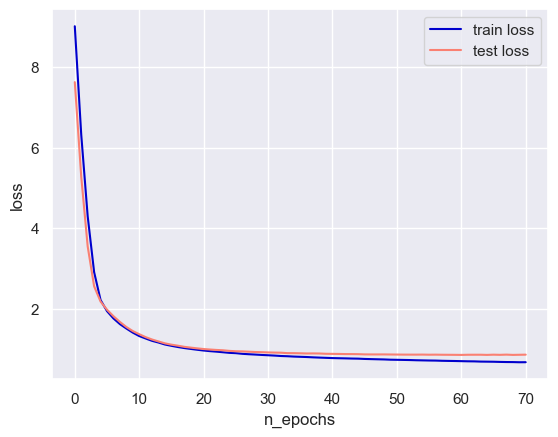

In [129]:
plot_loss(history)

## Модель 2

Попробую добавить функцию активации на выходом слое. 

In [130]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=12, activation='relu'))
model.add(Dense(units=32, activation='relu'))
model.add(Dense(units=1, activation='relu'))

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_3 (Dense)             (None, 12)                156       
                                                                 
 dense_4 (Dense)             (None, 32)                416       
                                                                 
 dense_5 (Dense)             (None, 1)                 33        
                                                                 
Total params: 630
Trainable params: 605
Non-trainable params: 25
_________________________________________________________________


In [131]:
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

In [132]:
history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop, save_model])

Epoch 1/100
20/21 [===========================>..] - ETA: 0s - loss: 8.5294 - mae: 2.7793
Epoch 1: val_loss did not improve from 0.85133
21/21 [==============================] - 7s 138ms/step - loss: 8.6033 - mae: 2.7895 - val_loss: 7.7688 - val_mae: 2.6231
Epoch 2/100
18/21 [========================>.....] - ETA: 0s - loss: 6.3871 - mae: 2.3465
Epoch 2: val_loss did not improve from 0.85133
21/21 [==============================] - 1s 45ms/step - loss: 6.3387 - mae: 2.3300 - val_loss: 5.0805 - val_mae: 2.0372
Epoch 3/100
20/21 [===========================>..] - ETA: 0s - loss: 3.9473 - mae: 1.7411
Epoch 3: val_loss did not improve from 0.85133
21/21 [==============================] - 1s 57ms/step - loss: 3.9085 - mae: 1.7306 - val_loss: 2.9470 - val_mae: 1.4461
Epoch 4/100
18/21 [========================>.....] - ETA: 0s - loss: 2.3008 - mae: 1.2655
Epoch 4: val_loss did not improve from 0.85133
21/21 [==============================] - 2s 91ms/step - loss: 2.2704 - mae: 1.2591 - val_lo

Epoch 33/100
16/21 [=====================>........] - ETA: 0s - loss: 0.8202 - mae: 0.7371
Epoch 33: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 15ms/step - loss: 0.8023 - mae: 0.7270 - val_loss: 0.9206 - val_mae: 0.7804
Epoch 34/100
15/21 [====================>.........] - ETA: 0s - loss: 0.8244 - mae: 0.7388
Epoch 34: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 15ms/step - loss: 0.7952 - mae: 0.7257 - val_loss: 0.9211 - val_mae: 0.7810
Epoch 35/100
15/21 [====================>.........] - ETA: 0s - loss: 0.8041 - mae: 0.7194
Epoch 35: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 14ms/step - loss: 0.7929 - mae: 0.7217 - val_loss: 0.9196 - val_mae: 0.7802
Epoch 36/100
17/21 [=======================>......] - ETA: 0s - loss: 0.7938 - mae: 0.7288
Epoch 36: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 14ms/step - loss: 0.7864 - mae: 0.7211 -

In [133]:
metrics_nn('Tr. params: 605, adam, relu, var.2', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 20ms/step


,Название модели,Выборка,MAE,R2_score
2,"Tr. params: 605, adam, relu, var.2",train,0.694839,0.075151
3,"Tr. params: 605, adam, relu, var.2",test,0.773337,-0.132527


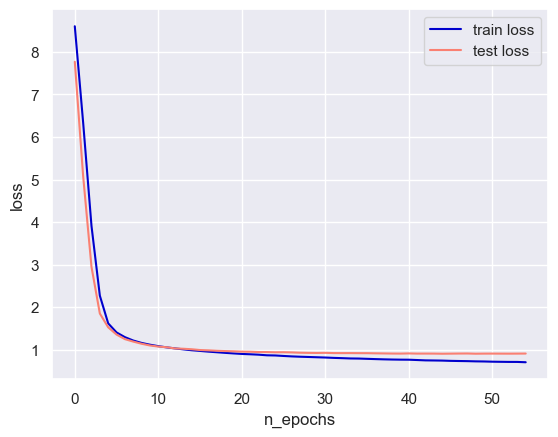

In [134]:
plot_loss(history)

## Модель 3

Попробую изменить функцию активации. На выходном слое уберу функцию активации.  

In [135]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=12, activation='tanh'))
model.add(Dense(units=32, activation='tanh'))
model.add(Dense(units=1))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_6 (Dense)             (None, 12)                156       
                                                                 
 dense_7 (Dense)             (None, 32)                416       
                                                                 
 dense_8 (Dense)             (None, 1)                 33        
                                                                 
Total params: 630
Trainable params: 605
Non-trainable params: 25
_________________________________________________________________


In [136]:
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

In [137]:
history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop, save_model])

Epoch 1/100
21/21 [==============================] - ETA: 0s - loss: 9.0749 - mae: 2.8386
Epoch 1: val_loss did not improve from 0.85133
21/21 [==============================] - 5s 85ms/step - loss: 9.0749 - mae: 2.8386 - val_loss: 8.8283 - val_mae: 2.8029
Epoch 2/100
20/21 [===========================>..] - ETA: 0s - loss: 8.0731 - mae: 2.6704
Epoch 2: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 20ms/step - loss: 8.0491 - mae: 2.6667 - val_loss: 7.9086 - val_mae: 2.6414
Epoch 3/100
19/21 [==========================>...] - ETA: 0s - loss: 7.1061 - mae: 2.4894
Epoch 3: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 19ms/step - loss: 7.0915 - mae: 2.4867 - val_loss: 6.9400 - val_mae: 2.4547
Epoch 4/100
20/21 [===========================>..] - ETA: 0s - loss: 6.0056 - mae: 2.2641
Epoch 4: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 21ms/step - loss: 6.0636 - mae: 2.2753 - val_los

Epoch 33/100
17/21 [=======================>......] - ETA: 0s - loss: 0.8059 - mae: 0.7343
Epoch 33: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 18ms/step - loss: 0.7875 - mae: 0.7217 - val_loss: 0.9039 - val_mae: 0.7615
Epoch 34/100
19/21 [==========================>...] - ETA: 0s - loss: 0.7742 - mae: 0.7168
Epoch 34: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 17ms/step - loss: 0.7837 - mae: 0.7209 - val_loss: 0.8921 - val_mae: 0.7599
Epoch 35/100
17/21 [=======================>......] - ETA: 0s - loss: 0.7930 - mae: 0.7259
Epoch 35: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 18ms/step - loss: 0.7826 - mae: 0.7210 - val_loss: 0.8945 - val_mae: 0.7569
Epoch 36/100
16/21 [=====================>........] - ETA: 0s - loss: 0.7690 - mae: 0.7164
Epoch 36: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 20ms/step - loss: 0.7769 - mae: 0.7180 -

Epoch 65/100
16/21 [=====================>........] - ETA: 0s - loss: 0.7147 - mae: 0.6866
Epoch 65: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 15ms/step - loss: 0.7230 - mae: 0.6894 - val_loss: 0.8677 - val_mae: 0.7461
Epoch 66/100
16/21 [=====================>........] - ETA: 0s - loss: 0.7395 - mae: 0.6979
Epoch 66: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 14ms/step - loss: 0.7214 - mae: 0.6879 - val_loss: 0.8637 - val_mae: 0.7437
Epoch 67/100
16/21 [=====================>........] - ETA: 0s - loss: 0.7311 - mae: 0.6856
Epoch 67: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 14ms/step - loss: 0.7167 - mae: 0.6862 - val_loss: 0.8723 - val_mae: 0.7471
Epoch 68/100
16/21 [=====================>........] - ETA: 0s - loss: 0.7216 - mae: 0.6912
Epoch 68: val_loss did not improve from 0.85133
21/21 [==============================] - 0s 14ms/step - loss: 0.7190 - mae: 0.6875 -

In [138]:
metrics_nn('Tr. params: 605, adam, tanh', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 14ms/step


,Название модели,Выборка,MAE,R2_score
4,"Tr. params: 605, adam, tanh",train,0.689060,0.098189
5,"Tr. params: 605, adam, tanh",test,0.743724,-0.074701


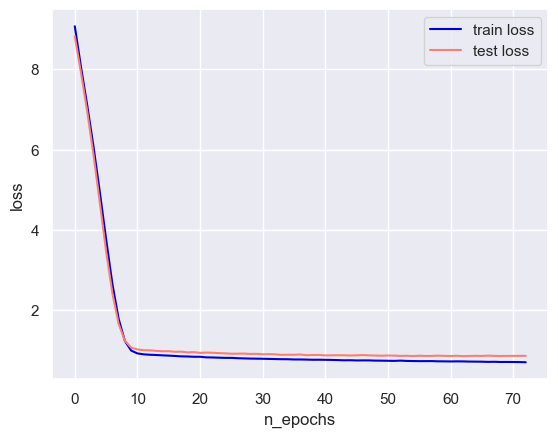

In [139]:
plot_loss(history)

## Модель 4

In [140]:
df_metrics_nn

,Название модели,Выборка,MAE,R2_score
0,"Tr. params: 605, adam, relu",train,0.673570,0.134573
1,"Tr. params: 605, adam, relu",test,0.744656,-0.064003
2,"Tr. params: 605, adam, relu, var.2",train,0.694839,0.075151
3,"Tr. params: 605, adam, relu, var.2",test,0.773337,-0.132527
4,"Tr. params: 605, adam, tanh",train,0.689060,0.098189
5,"Tr. params: 605, adam, tanh",test,0.743724,-0.074701


Возьму за основу последнюю модель, т.к. там меньше всего ошибка на тестовой выборке. И буду наоборот уменьшать количество нейронов с каждым слоем. 

In [141]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=32, activation='tanh'))
model.add(Dense(units=16, activation='tanh'))
model.add(Dense(units=1))

model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_9 (Dense)             (None, 32)                416       
                                                                 
 dense_10 (Dense)            (None, 16)                528       
                                                                 
 dense_11 (Dense)            (None, 1)                 17        
                                                                 
Total params: 986
Trainable params: 961
Non-trainable params: 25
_________________________________________________________________


In [142]:
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop])

Epoch 1/100
21/21 [==============================] - 5s 71ms/step - loss: 9.1434 - mae: 2.8350 - val_loss: 8.8410 - val_mae: 2.7860
Epoch 2/100
21/21 [==============================] - 0s 17ms/step - loss: 7.8953 - mae: 2.6326 - val_loss: 7.7102 - val_mae: 2.5950
Epoch 3/100
21/21 [==============================] - 0s 15ms/step - loss: 6.7201 - mae: 2.4116 - val_loss: 6.5088 - val_mae: 2.3617
Epoch 4/100
21/21 [==============================] - 0s 15ms/step - loss: 5.4567 - mae: 2.1421 - val_loss: 5.1594 - val_mae: 2.0678
Epoch 5/100
21/21 [==============================] - 0s 16ms/step - loss: 4.0755 - mae: 1.8036 - val_loss: 3.7158 - val_mae: 1.7009
Epoch 6/100
21/21 [==============================] - 0s 16ms/step - loss: 2.7299 - mae: 1.4141 - val_loss: 2.3812 - val_mae: 1.2993
Epoch 7/100
21/21 [==============================] - 0s 17ms/step - loss: 1.6480 - mae: 1.0508 - val_loss: 1.4655 - val_mae: 0.9852
Epoch 8/100
21/21 [==============================] - 0s 16ms/step - loss: 1.

In [143]:
metrics_nn('Tr. params: 961, adam, tanh', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 5ms/step


,Название модели,Выборка,MAE,R2_score
6,"Tr. params: 961, adam, tanh",train,0.685445,0.082593
7,"Tr. params: 961, adam, tanh",test,0.764502,-0.124272


In [144]:
df_metrics_nn

,Название модели,Выборка,MAE,R2_score
0,"Tr. params: 605, adam, relu",train,0.673570,0.134573
1,"Tr. params: 605, adam, relu",test,0.744656,-0.064003
2,"Tr. params: 605, adam, relu, var.2",train,0.694839,0.075151
3,"Tr. params: 605, adam, relu, var.2",test,0.773337,-0.132527
4,"Tr. params: 605, adam, tanh",train,0.689060,0.098189
5,"Tr. params: 605, adam, tanh",test,0.743724,-0.074701
6,"Tr. params: 961, adam, tanh",train,0.685445,0.082593
7,"Tr. params: 961, adam, tanh",test,0.764502,-0.124272


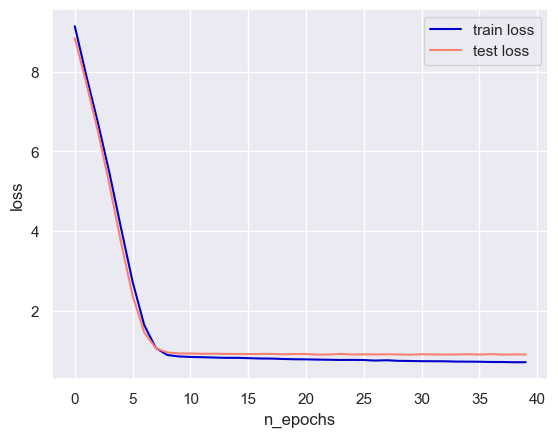

In [145]:
plot_loss(history)

## Модель 5

Добавлю слой.



In [146]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=64, activation='tanh'))
model.add(Dense(units=32, activation='tanh'))
model.add(Dense(units=16, activation='tanh'))
model.add(Dense(units=1))

model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_12 (Dense)            (None, 64)                832       
                                                                 
 dense_13 (Dense)            (None, 32)                2080      
                                                                 
 dense_14 (Dense)            (None, 16)                528       
                                                                 
 dense_15 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,482
Trainable params: 3,457
Non-trainable params: 25
___________________________________________________

In [147]:
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop])

Epoch 1/100
21/21 [==============================] - 5s 80ms/step - loss: 8.4701 - mae: 2.7240 - val_loss: 7.5057 - val_mae: 2.5635
Epoch 2/100
21/21 [==============================] - 0s 19ms/step - loss: 5.7795 - mae: 2.2102 - val_loss: 4.7197 - val_mae: 1.9543
Epoch 3/100
21/21 [==============================] - 0s 15ms/step - loss: 2.9341 - mae: 1.4698 - val_loss: 1.8630 - val_mae: 1.1420
Epoch 4/100
21/21 [==============================] - 0s 15ms/step - loss: 1.0947 - mae: 0.8363 - val_loss: 0.9258 - val_mae: 0.7559
Epoch 5/100
21/21 [==============================] - 0s 14ms/step - loss: 0.8434 - mae: 0.7411 - val_loss: 0.9075 - val_mae: 0.7521
Epoch 6/100
21/21 [==============================] - 0s 13ms/step - loss: 0.8268 - mae: 0.7315 - val_loss: 0.9073 - val_mae: 0.7473
Epoch 7/100
21/21 [==============================] - 0s 13ms/step - loss: 0.8072 - mae: 0.7233 - val_loss: 0.9047 - val_mae: 0.7506
Epoch 8/100
21/21 [==============================] - 0s 14ms/step - loss: 0.

In [148]:
metrics_nn('Tr. params: 3,457, adam, tanh', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 5ms/step


,Название модели,Выборка,MAE,R2_score
8,"Tr. params: 3,457, adam, tanh",train,0.687784,0.096216
9,"Tr. params: 3,457, adam, tanh",test,0.741734,-0.112369


In [149]:
df_metrics_nn

,Название модели,Выборка,MAE,R2_score
0,"Tr. params: 605, adam, relu",train,0.673570,0.134573
1,"Tr. params: 605, adam, relu",test,0.744656,-0.064003
2,"Tr. params: 605, adam, relu, var.2",train,0.694839,0.075151
3,"Tr. params: 605, adam, relu, var.2",test,0.773337,-0.132527
4,"Tr. params: 605, adam, tanh",train,0.689060,0.098189
5,"Tr. params: 605, adam, tanh",test,0.743724,-0.074701
6,"Tr. params: 961, adam, tanh",train,0.685445,0.082593
7,"Tr. params: 961, adam, tanh",test,0.764502,-0.124272
8,"Tr. params: 3,457, adam, tanh",train,0.687784,0.096216
9,"Tr. params: 3,457, adam, tanh",test,0.741734,-0.112369


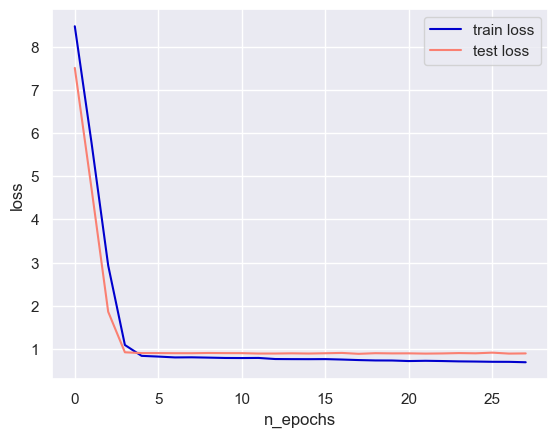

In [150]:
plot_loss(history)

## Модель 6

Попробую улучшить последнюю модель.

In [151]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=64, activation='tanh'))
model.add(Dense(units=32, activation='tanh'))
model.add(Dense(units=16, activation='tanh'))
model.add(Dense(units=1))

model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_16 (Dense)            (None, 64)                832       
                                                                 
 dense_17 (Dense)            (None, 32)                2080      
                                                                 
 dense_18 (Dense)            (None, 16)                528       
                                                                 
 dense_19 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,482
Trainable params: 3,457
Non-trainable params: 25
___________________________________________________

In [152]:
model.compile(optimizer=tf.optimizers.SGD(learning_rate=0.05), loss='mse', metrics=['mae'])

history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop])

Epoch 1/100
21/21 [==============================] - 2s 33ms/step - loss: 1.3868 - mae: 0.9151 - val_loss: 0.9298 - val_mae: 0.7620
Epoch 2/100
21/21 [==============================] - 0s 9ms/step - loss: 0.8385 - mae: 0.7428 - val_loss: 0.8352 - val_mae: 0.7224
Epoch 3/100
21/21 [==============================] - 0s 9ms/step - loss: 0.8239 - mae: 0.7337 - val_loss: 0.8517 - val_mae: 0.7365
Epoch 4/100
21/21 [==============================] - 0s 9ms/step - loss: 0.8040 - mae: 0.7241 - val_loss: 0.8248 - val_mae: 0.7272
Epoch 5/100
21/21 [==============================] - 0s 9ms/step - loss: 0.7771 - mae: 0.7138 - val_loss: 0.8207 - val_mae: 0.7178
Epoch 6/100
21/21 [==============================] - 0s 9ms/step - loss: 0.7686 - mae: 0.7085 - val_loss: 0.8491 - val_mae: 0.7329
Epoch 7/100
21/21 [==============================] - 0s 9ms/step - loss: 0.7659 - mae: 0.7067 - val_loss: 0.9158 - val_mae: 0.7644
Epoch 8/100
21/21 [==============================] - 0s 9ms/step - loss: 0.7546 - 

In [153]:
metrics_nn('Tr. params: 605, SGD, lr=0.05, tanh', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 5ms/step


,Название модели,Выборка,MAE,R2_score
10,"Tr. params: 605, SGD, lr=0.05, tanh",train,0.689377,0.079132
11,"Tr. params: 605, SGD, lr=0.05, tanh",test,0.717792,-0.025661


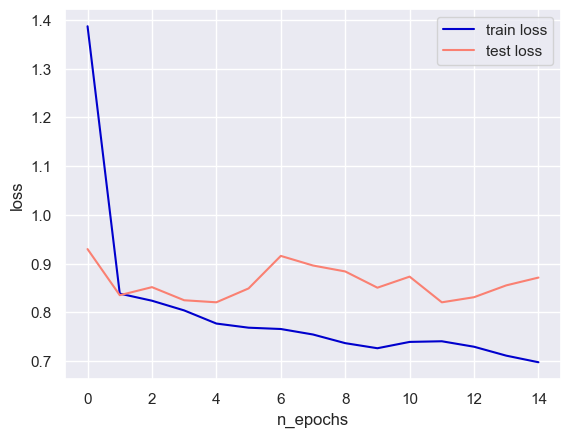

In [154]:
plot_loss(history)

## Модель 7

Изменю learning rate. 

In [155]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=64, activation='tanh'))
model.add(Dense(units=32, activation='tanh'))
model.add(Dense(units=16, activation='tanh'))
model.add(Dense(units=1))

model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_20 (Dense)            (None, 64)                832       
                                                                 
 dense_21 (Dense)            (None, 32)                2080      
                                                                 
 dense_22 (Dense)            (None, 16)                528       
                                                                 
 dense_23 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,482
Trainable params: 3,457
Non-trainable params: 25
___________________________________________________

In [156]:
model.compile(optimizer=tf.optimizers.SGD(learning_rate=0.01), loss='mse', metrics=['mae'])

history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop])

Epoch 1/100
21/21 [==============================] - 3s 33ms/step - loss: 3.2590 - mae: 1.4684 - val_loss: 0.9703 - val_mae: 0.7780
Epoch 2/100
21/21 [==============================] - 0s 9ms/step - loss: 0.8745 - mae: 0.7580 - val_loss: 0.8479 - val_mae: 0.7234
Epoch 3/100
21/21 [==============================] - 0s 13ms/step - loss: 0.8415 - mae: 0.7406 - val_loss: 0.8357 - val_mae: 0.7185
Epoch 4/100
21/21 [==============================] - 0s 16ms/step - loss: 0.8275 - mae: 0.7371 - val_loss: 0.8300 - val_mae: 0.7205
Epoch 5/100
21/21 [==============================] - 0s 14ms/step - loss: 0.8200 - mae: 0.7323 - val_loss: 0.8399 - val_mae: 0.7217
Epoch 6/100
21/21 [==============================] - 0s 15ms/step - loss: 0.8091 - mae: 0.7297 - val_loss: 0.8335 - val_mae: 0.7210
Epoch 7/100
21/21 [==============================] - 0s 14ms/step - loss: 0.8072 - mae: 0.7259 - val_loss: 0.8304 - val_mae: 0.7179
Epoch 8/100
21/21 [==============================] - 0s 14ms/step - loss: 0.8

In [157]:
metrics_nn('Tr. params: 605, SGD, lr=0.01, tanh', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 5ms/step


,Название модели,Выборка,MAE,R2_score
12,"Tr. params: 605, SGD, lr=0.01, tanh",train,0.699283,0.059173
13,"Tr. params: 605, SGD, lr=0.01, tanh",test,0.714272,-0.017537


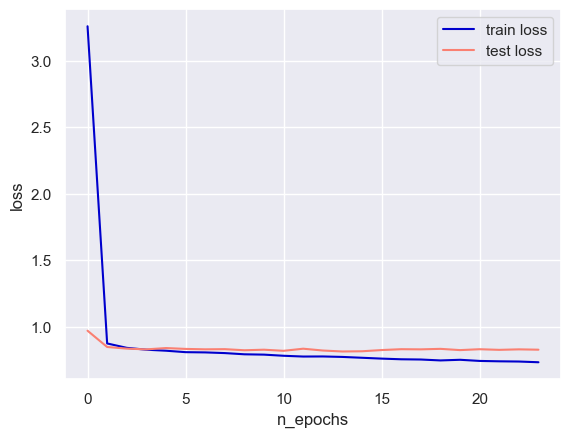

In [158]:
plot_loss(history)

## Модель 8

Отбрасываю идею выбрать другой optimizer. Добавлю вместо этого слои Dropout.

In [159]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=64, activation='tanh'))
model.add(Dropout(0.05))
model.add(Dense(units=32, activation='tanh'))
model.add(Dropout(0.05))
model.add(Dense(units=16, activation='tanh'))
model.add(Dense(units=1))

model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_24 (Dense)            (None, 64)                832       
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_25 (Dense)            (None, 32)                2080      
                                                                 
 dropout_1 (Dropout)         (None, 32)                0         
                                                                 
 dense_26 (Dense)            (None, 16)                528       
                                                      

In [160]:
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop])

Epoch 1/100
21/21 [==============================] - 5s 61ms/step - loss: 8.6020 - mae: 2.7401 - val_loss: 7.5140 - val_mae: 2.5750
Epoch 2/100
21/21 [==============================] - 0s 21ms/step - loss: 6.1496 - mae: 2.2796 - val_loss: 5.0377 - val_mae: 2.0450
Epoch 3/100
21/21 [==============================] - 0s 23ms/step - loss: 3.6009 - mae: 1.6388 - val_loss: 2.2444 - val_mae: 1.2712
Epoch 4/100
21/21 [==============================] - 0s 19ms/step - loss: 1.5014 - mae: 0.9843 - val_loss: 0.9444 - val_mae: 0.7703
Epoch 5/100
21/21 [==============================] - 1s 32ms/step - loss: 1.0489 - mae: 0.8200 - val_loss: 0.8776 - val_mae: 0.7529
Epoch 6/100
21/21 [==============================] - 0s 23ms/step - loss: 1.0528 - mae: 0.8241 - val_loss: 0.8534 - val_mae: 0.7427
Epoch 7/100
21/21 [==============================] - 1s 24ms/step - loss: 1.0070 - mae: 0.7970 - val_loss: 0.8574 - val_mae: 0.7357
Epoch 8/100
21/21 [==============================] - 0s 18ms/step - loss: 1.

In [161]:
metrics_nn('Tr. params: 3,457, adam, tanh, + Dropout(5%)', 
           model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 5ms/step


,Название модели,Выборка,MAE,R2_score
14,"Tr. params: 3,457, adam, tanh, + Dropout(5%)",train,0.694141,0.073829
15,"Tr. params: 3,457, adam, tanh, + Dropout(5%)",test,0.718433,-0.013166


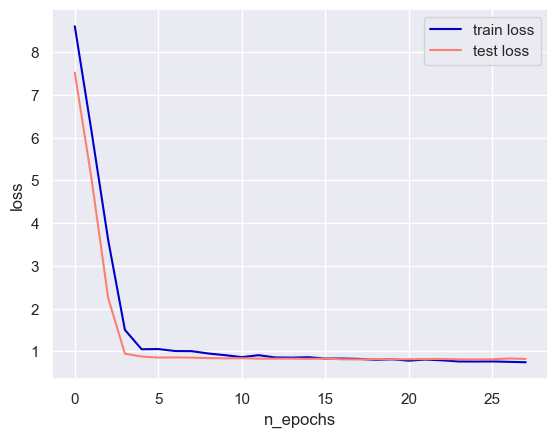

In [162]:
plot_loss(history)

## Модель 9

In [163]:
model = Sequential()
model.add(normalizer)
model.add(Dense(units=64, activation='tanh'))
model.add(Dropout(0.25))
model.add(Dense(units=32, activation='tanh'))
model.add(Dropout(0.25))
model.add(Dense(units=16, activation='tanh'))
model.add(Dense(units=1))

model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 12)               25        
 n)                                                              
                                                                 
 dense_28 (Dense)            (None, 64)                832       
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                                                                 
 dense_29 (Dense)            (None, 32)                2080      
                                                                 
 dropout_3 (Dropout)         (None, 32)                0         
                                                                 
 dense_30 (Dense)            (None, 16)                528       
                                                      

In [164]:
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

history=model.fit(
    X_train, 
    y_train,
    epochs=n_epochs,
    verbose=1,
    validation_data=(X_test, y_test),
    callbacks=[early_stop])

Epoch 1/100
21/21 [==============================] - 5s 66ms/step - loss: 8.8135 - mae: 2.7742 - val_loss: 7.7957 - val_mae: 2.6217
Epoch 2/100
21/21 [==============================] - 1s 28ms/step - loss: 6.8959 - mae: 2.4260 - val_loss: 5.5331 - val_mae: 2.1661
Epoch 3/100
21/21 [==============================] - 0s 22ms/step - loss: 4.8255 - mae: 1.9380 - val_loss: 2.9309 - val_mae: 1.4838
Epoch 4/100
21/21 [==============================] - 1s 36ms/step - loss: 2.7550 - mae: 1.3461 - val_loss: 1.0958 - val_mae: 0.8417
Epoch 5/100
21/21 [==============================] - 0s 17ms/step - loss: 1.6535 - mae: 1.0229 - val_loss: 0.8728 - val_mae: 0.7385
Epoch 6/100
21/21 [==============================] - 0s 16ms/step - loss: 1.3528 - mae: 0.9332 - val_loss: 0.9232 - val_mae: 0.7651
Epoch 7/100
21/21 [==============================] - 1s 28ms/step - loss: 1.3222 - mae: 0.9392 - val_loss: 0.8738 - val_mae: 0.7380
Epoch 8/100
21/21 [==============================] - 1s 32ms/step - loss: 1.

In [165]:
metrics_nn('Tr. params: 3,457, adam, tanh, + Dropout(25%)', model, X_train, X_test, y_train, y_test, df_metrics_nn)

9/9 [==============================] - 0s 6ms/step


,Название модели,Выборка,MAE,R2_score
16,"Tr. params: 3,457, adam, tanh, + Dropout(25%)",train,0.709023,0.041132
17,"Tr. params: 3,457, adam, tanh, + Dropout(25%)",test,0.704791,0.020348


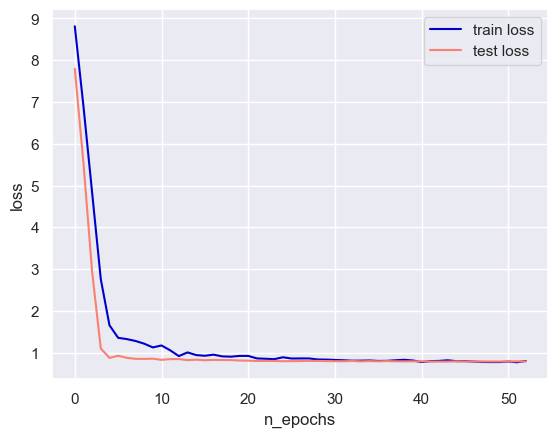

In [166]:
plot_loss(history)

In [167]:
df_metrics_nn[df_metrics_nn.Выборка=='test']

,Название модели,Выборка,MAE,R2_score
1,"Tr. params: 605, adam, relu",test,0.744656,-0.064003
3,"Tr. params: 605, adam, relu, var.2",test,0.773337,-0.132527
5,"Tr. params: 605, adam, tanh",test,0.743724,-0.074701
7,"Tr. params: 961, adam, tanh",test,0.764502,-0.124272
9,"Tr. params: 3,457, adam, tanh",test,0.741734,-0.112369
11,"Tr. params: 605, SGD, lr=0.05, tanh",test,0.717792,-0.025661
13,"Tr. params: 605, SGD, lr=0.01, tanh",test,0.714272,-0.017537
15,"Tr. params: 3,457, adam, tanh, + Dropout(5%)",test,0.718433,-0.013166
17,"Tr. params: 3,457, adam, tanh, + Dropout(25%)",test,0.704791,0.020348


Буду сохранять эту последнюю модель, т.к. она показала лучшие результаты. 

# Сохранение модели

## Сохранение модели регрессии 

In [168]:
import pickle

Сохраняю модель регрессии, а также scaler-ы для нормализации и обратной нормализации данных. Закомментила, чтобы при повторном выполнении ноутбука модели не пересохранялись.

In [169]:
# pickle.dump(regr_svr, open('app_flask/models/svr_regression.pkl', 'wb'))
# pickle.dump(minmax_X, open('app_flask/models/minmax_X.pkl', 'wb'))
# pickle.dump(minmax_y, open('app_flask/models/minmax_y.pkl', 'wb'))

Далее загружаю модели в переменные.

In [170]:
model_svr_load = pickle.load(open('app_flask/models/svr_regression.pkl', 'rb'))

In [171]:
model_minmax_X_load = pickle.load(open('app_flask/models/minmax_X.pkl', 'rb'))

In [172]:
model_minmax_y_load = pickle.load(open('app_flask/models/minmax_y.pkl', 'rb'))

И далее проверяю работоспособность приложения на тестовых данных. 

In [173]:
# переменная X_test_reg задана в разделе Нормализация
# это то, что нужно будет ввести при тесте приложения
X_test_reg[0,:]

array([   3.098, 1954.917,  703.755,  125.8  ,   25.002,  269.252,
        538.997,  280.855,   90.   ,    6.732,   74.109])

In [174]:
# вот что происходит с переменной внутри модели
X_test_reg_norm = minmax_X.transform(X_test_reg[0,:].reshape(1, 11))
X_test_reg_norm

array([[0.535, 0.452, 0.426, 0.609, 0.702, 0.435, 0.417, 0.735, 1.   ,
        0.489, 0.797]])

In [175]:
# нормированные предсказания
model_svr_load.predict(X_test_reg_norm)

array([[0.467, 0.504]])

In [176]:
# реальные предсказания
pr = model_minmax_y_load.inverse_transform(model_svr_load.predict(X_test_reg_norm)[0,:].reshape(1,2))
pr

array([[  72.966, 2487.331]])

In [177]:
pr1 = round(pr[0][0], 3)
pr2 = round(pr[0][1], 3)

In [178]:
# возможный вывод результата
f"Модуль упругости при растяжении, ГПа {pr1} | Прочность при растяжении, МПа {pr2}"

'Модуль упругости при растяжении, ГПа 72.966 | Прочность при растяжении, МПа 2487.331'

## Сохранение модели нейронной сети

Также закомменчиваю сохранение модели во избежание перезаписи. 

In [179]:
#model.save('app_flask/models/model_nn')

INFO:tensorflow:Assets written to: app_flask/models/model_nn\assets


Загружаю модель в переменную

In [180]:
model_nn_loaded = keras.models.load_model('app_flask/models/model_nn')

Оставляю тестовые данные для дальнейшей проверки приложения. 

In [181]:
# это то, что нужно ввести для проверки приложения
X_test[1,:]

array([1917.784,  764.787,   91.66 ,   22.676,  317.474,  422.07 ,
         69.076, 2250.211,  321.146,    0.   ,    4.985,   38.307])

In [182]:
X_test[1,:].shape

(12,)

In [183]:
X_test[1,:].reshape(1, 12)

array([[1917.784,  764.787,   91.66 ,   22.676,  317.474,  422.07 ,
          69.076, 2250.211,  321.146,    0.   ,    4.985,   38.307]])

In [184]:
# предсказания
model_nn_loaded.predict(X_test[1,:].reshape(1, 12))

1/1 [==============================] - 0s 178ms/step


array([[3.039]], dtype=float32)